🚀 STARTING COMPREHENSIVE MANHATTAN BUILDING ANALYSIS
Loading Manhattan building data...
Loaded 5000 buildings

=== BASIC STATISTICAL ANALYSIS ===
count          :  5000.00 ft
mean           :   414.32 ft
median         :   257.73 ft
std            :   390.98 ft
min            :    21.21 ft
max            :  1500.00 ft
skewness       :     1.54 ft
kurtosis       :     1.48 ft
q25            :   140.75 ft
q75            :   535.35 ft

=== HEIGHT DISTRIBUTION ANALYSIS ===


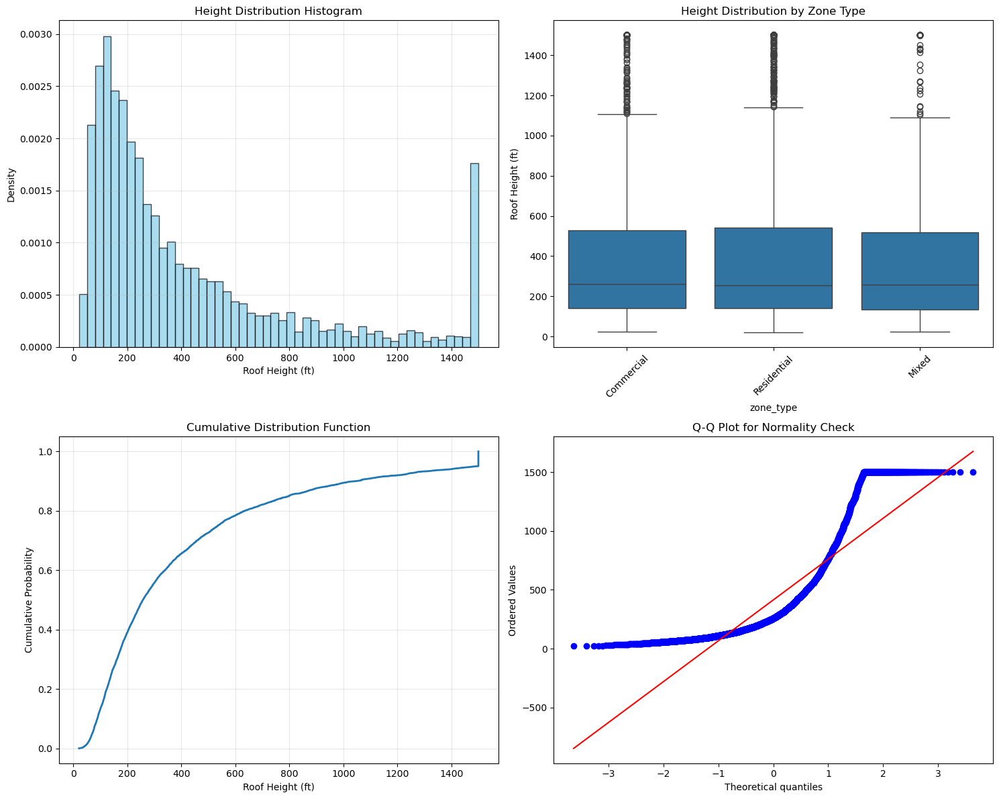


=== SPATIAL AUTOCORRELATION ANALYSIS ===
Moran's I: 0.3866
P-value: 0.0010
Z-score: 29.3009


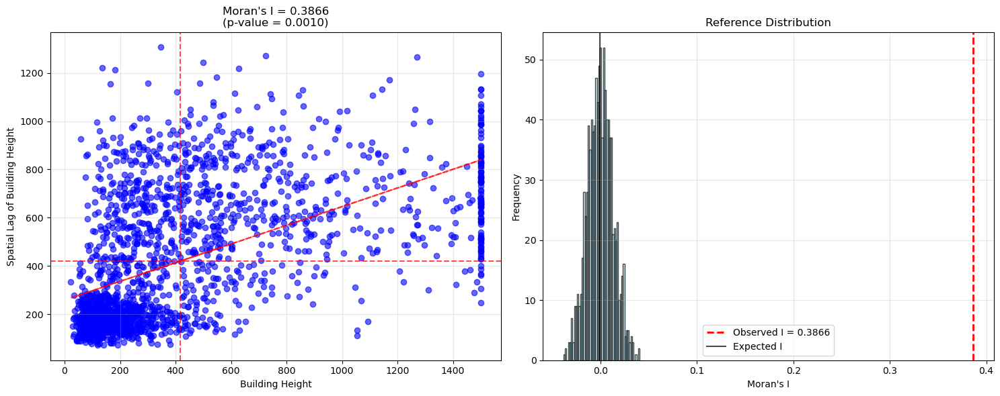


=== CLUSTERING ANALYSIS ===
Number of clusters identified: 3
Number of noise points: 110


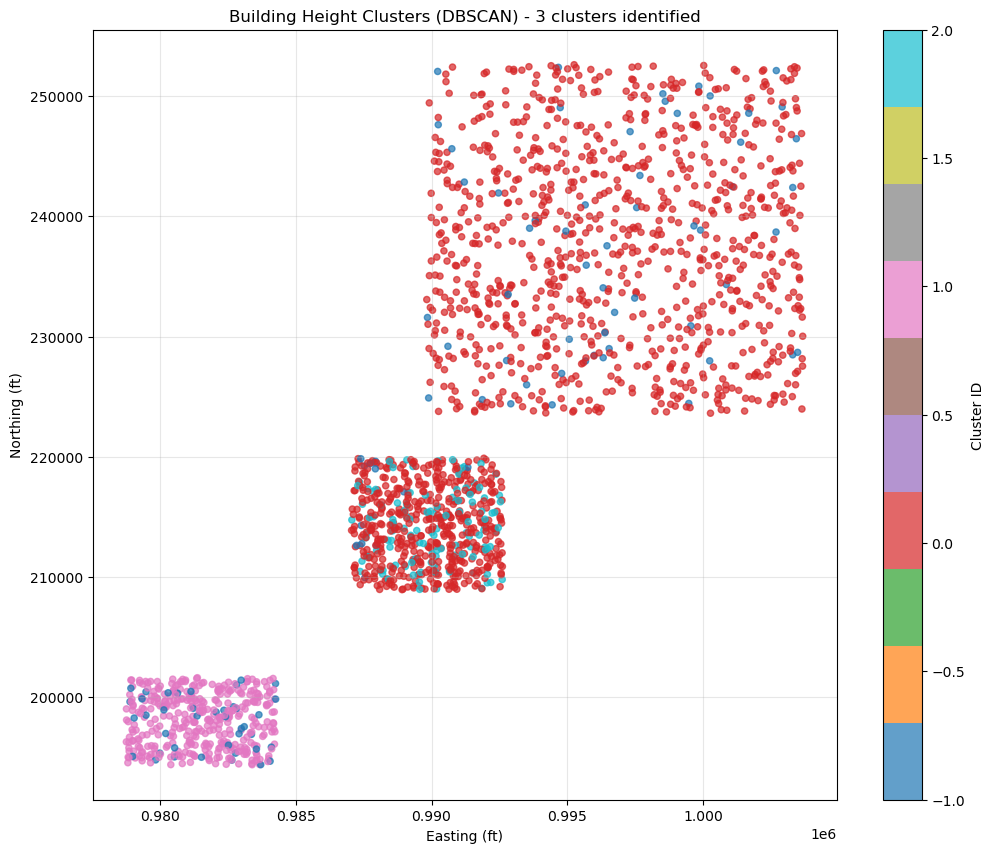


=== CREATING BUILDING HEIGHT MAP ===


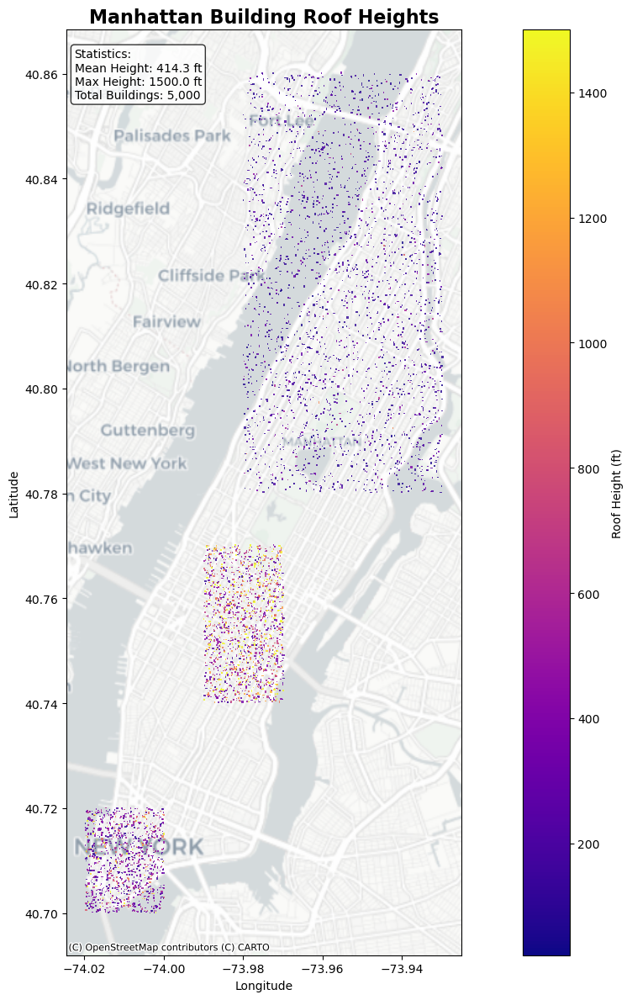


=== CREATING INTERACTIVE MAP ===
✅ Interactive map saved to outputs/maps/interactive_height_map.html

=== TEMPORAL ANALYSIS ===


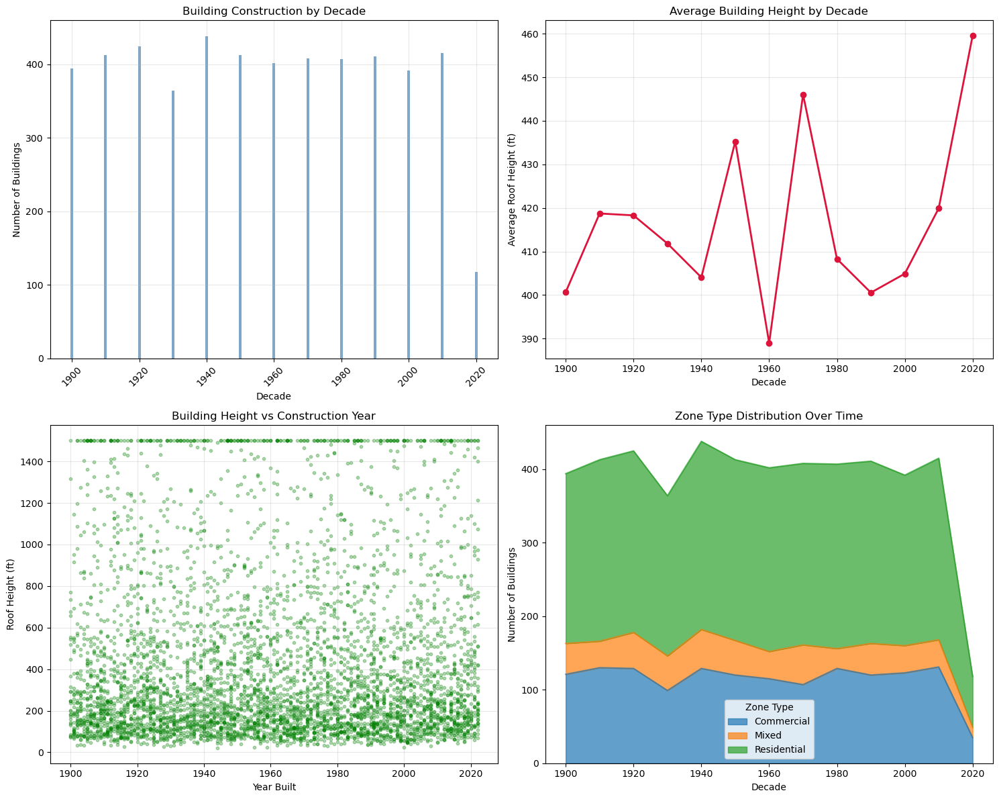


=== ADVANCED SPATIAL ANALYSIS ===


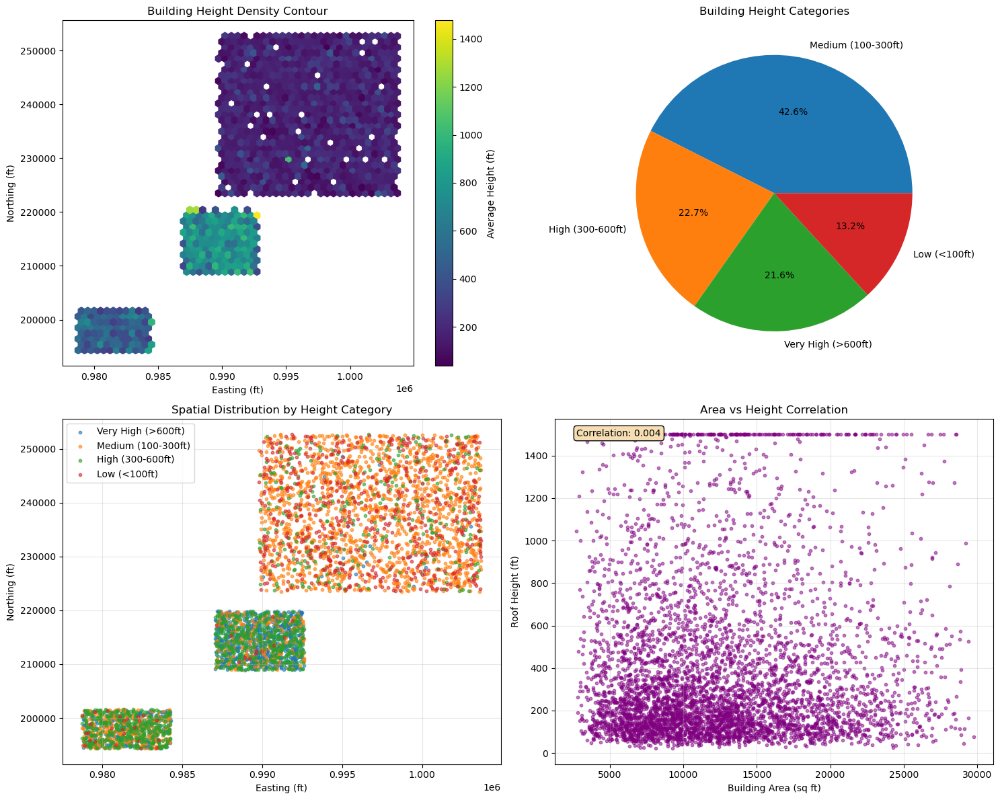

Analysis report saved to outputs/reports/analysis_report.txt

✅ ANALYSIS COMPLETE!
Check outputs/ folder for all visualizations and reports


In [3]:
# manhattan_building_analysis.py
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Point, Polygon
import contextily as ctx
from scipy import stats
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import folium
from folium.plugins import HeatMap
import libpysal as lps
from esda.moran import Moran
import osmnx as ox
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

class ManhattanBuildingAnalyzer:
    def __init__(self):
        self.buildings_gdf = None
        self.manhattan_boundary = None
        self.results = {}
        
    def load_sample_data(self):
        """
        Create synthetic Manhattan building data for demonstration
        In practice, you would load from NYC OpenData
        """
        print("Loading Manhattan building data...")
        
        # Create synthetic building footprints for Manhattan
        np.random.seed(42)
        
        buildings = []
        n_buildings = 5000
        
        for i in range(n_buildings):
            # Create realistic Manhattan distribution
            if i < 1000:  # Downtown (Financial District)
                lon = np.random.uniform(-74.02, -74.00)
                lat = np.random.uniform(40.70, 40.72)
                height = np.random.lognormal(6.0, 0.7)  # Tall buildings
            elif i < 2500:  # Midtown
                lon = np.random.uniform(-73.99, -73.97)
                lat = np.random.uniform(40.74, 40.77)
                height = np.random.lognormal(6.5, 0.8)  # Very tall
            else:  # Uptown and other areas
                lon = np.random.uniform(-73.98, -73.93)
                lat = np.random.uniform(40.78, 40.86)
                height = np.random.lognormal(5.0, 0.6)  # Medium height
            
            # Cap unrealistic heights for realism
            height = min(height, 1500)
            
            # Create building footprint
            width = np.random.uniform(50, 200)
            depth = np.random.uniform(50, 150)
            
            footprint = Polygon([
                (lon, lat),
                (lon + width/364000, lat),
                (lon + width/364000, lat + depth/364000),
                (lon, lat + depth/364000)
            ])
            
            buildings.append({
                'geometry': footprint,
                'roof_height': height,
                'building_id': f"bld_{i:05d}",
                'area_sqft': width * depth,
                'zone_type': np.random.choice(['Commercial', 'Residential', 'Mixed'], 
                                            p=[0.3, 0.6, 0.1]),
                'year_built': np.random.randint(1900, 2023)
            })
        
        self.buildings_gdf = gpd.GeoDataFrame(buildings, crs="EPSG:4326")
        print(f"Loaded {len(self.buildings_gdf)} buildings")
        
    def basic_statistical_analysis(self):
        """Comprehensive statistical analysis of building heights"""
        print("\n=== BASIC STATISTICAL ANALYSIS ===")
        
        heights = self.buildings_gdf['roof_height']
        
        stats_summary = {
            'count': len(heights),
            'mean': heights.mean(),
            'median': heights.median(),
            'std': heights.std(),
            'min': heights.min(),
            'max': heights.max(),
            'skewness': heights.skew(),
            'kurtosis': heights.kurtosis(),
            'q25': heights.quantile(0.25),
            'q75': heights.quantile(0.75)
        }
        
        # Print statistics
        for key, value in stats_summary.items():
            print(f"{key:15}: {value:8.2f} ft")
        
        self.results['basic_stats'] = stats_summary
        return stats_summary
    
    def height_distribution_analysis(self):
        """Analyze height distribution and create visualizations"""
        print("\n=== HEIGHT DISTRIBUTION ANALYSIS ===")
        
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        heights = self.buildings_gdf['roof_height']
        
        # 1. Histogram with KDE
        axes[0,0].hist(heights, bins=50, density=True, alpha=0.7, color='skyblue', edgecolor='black')
        axes[0,0].set_xlabel('Roof Height (ft)')
        axes[0,0].set_ylabel('Density')
        axes[0,0].set_title('Height Distribution Histogram')
        axes[0,0].grid(True, alpha=0.3)
        
        # 2. Box plot by zone type
        sns.boxplot(data=self.buildings_gdf, x='zone_type', y='roof_height', ax=axes[0,1])
        axes[0,1].set_title('Height Distribution by Zone Type')
        axes[0,1].set_ylabel('Roof Height (ft)')
        axes[0,1].tick_params(axis='x', rotation=45)
        
        # 3. Cumulative distribution
        sorted_heights = np.sort(heights)
        cdf = np.arange(1, len(sorted_heights)+1) / len(sorted_heights)
        axes[1,0].plot(sorted_heights, cdf, linewidth=2)
        axes[1,0].set_xlabel('Roof Height (ft)')
        axes[1,0].set_ylabel('Cumulative Probability')
        axes[1,0].set_title('Cumulative Distribution Function')
        axes[1,0].grid(True, alpha=0.3)
        
        # 4. QQ plot for normality check
        stats.probplot(heights, dist="norm", plot=axes[1,1])
        axes[1,1].set_title('Q-Q Plot for Normality Check')
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/height_distribution_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def spatial_autocorrelation_analysis(self):
        """Perform spatial autocorrelation analysis using Moran's I"""
        print("\n=== SPATIAL AUTOCORRELATION ANALYSIS ===")
        
        # Convert to projected CRS for accurate distance calculations
        buildings_projected = self.buildings_gdf.to_crs('EPSG:2263')
        
        # Calculate centroids
        buildings_projected['centroid'] = buildings_projected.geometry.centroid
        buildings_projected['x'] = buildings_projected.centroid.x
        buildings_projected['y'] = buildings_projected.centroid.y
        
        # Sample a subset for performance
        sample_size = min(2000, len(buildings_projected))
        buildings_sample = buildings_projected.sample(n=sample_size, random_state=42)
        
        # Create spatial weights matrix
        coords = list(zip(buildings_sample['x'], buildings_sample['y']))
        knn = lps.weights.KNN.from_array(coords, k=5)
        
        # Calculate Moran's I
        moran = Moran(buildings_sample['roof_height'], knn)
        
        print(f"Moran's I: {moran.I:.4f}")
        print(f"P-value: {moran.p_sim:.4f}")
        print(f"Z-score: {moran.z_sim:.4f}")
        
        # Create custom Moran plot
        self._create_custom_moran_plot(moran, buildings_sample)
        
        self.results['morans_i'] = {
            'I': moran.I,
            'p_value': moran.p_sim,
            'z_score': moran.z_sim
        }
    
    def _create_custom_moran_plot(self, moran, buildings_sample):
        """Create a custom Moran plot without using splot"""
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
        
        # Moran scatter plot
        lag = lps.weights.lag_spatial(moran.w, moran.y)
        ax1.scatter(moran.y, lag, alpha=0.6, color='blue')
        
        # Add reference lines
        ax1.axhline(y=lag.mean(), color='red', linestyle='--', alpha=0.7)
        ax1.axvline(x=moran.y.mean(), color='red', linestyle='--', alpha=0.7)
        
        # Add trend line
        z = np.polyfit(moran.y, lag, 1)
        p = np.poly1d(z)
        ax1.plot(moran.y, p(moran.y), "r--", alpha=0.8)
        
        ax1.set_xlabel('Building Height')
        ax1.set_ylabel('Spatial Lag of Building Height')
        ax1.set_title(f"Moran's I = {moran.I:.4f}\n(p-value = {moran.p_sim:.4f})")
        ax1.grid(True, alpha=0.3)
        
        # Moran's I distribution plot
        ax2.hist(moran.sim, bins=50, alpha=0.7, color='lightblue', edgecolor='black')
        ax2.axvline(moran.I, color='red', linestyle='--', linewidth=2, label=f"Observed I = {moran.I:.4f}")
        ax2.axvline(np.mean(moran.sim), color='black', linestyle='-', alpha=0.7, label='Expected I')
        ax2.set_xlabel("Moran's I")
        ax2.set_ylabel('Frequency')
        ax2.set_title('Reference Distribution')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/spatial_autocorrelation.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def clustering_analysis(self):
        """Identify building height clusters using DBSCAN"""
        print("\n=== CLUSTERING ANALYSIS ===")
        
        # Prepare data for clustering
        buildings_projected = self.buildings_gdf.to_crs('EPSG:2263')
        buildings_projected['centroid'] = buildings_projected.geometry.centroid
        buildings_projected['x'] = buildings_projected.centroid.x
        buildings_projected['y'] = buildings_projected.centroid.y
        
        # Sample for performance
        sample_size = min(2000, len(buildings_projected))
        buildings_sample = buildings_projected.sample(n=sample_size, random_state=42)
        
        # Features for clustering: location and height
        X = buildings_sample[['x', 'y', 'roof_height']].values
        X_scaled = StandardScaler().fit_transform(X)
        
        # Perform DBSCAN clustering
        dbscan = DBSCAN(eps=0.3, min_samples=15)
        clusters = dbscan.fit_predict(X_scaled)
        
        buildings_sample['cluster'] = clusters
        
        # Analyze clusters
        unique_clusters = np.unique(clusters)
        n_clusters = len(unique_clusters) - (1 if -1 in unique_clusters else 0)
        
        print(f"Number of clusters identified: {n_clusters}")
        print(f"Number of noise points: {np.sum(clusters == -1)}")
        
        # Visualize clusters
        fig, ax = plt.subplots(figsize=(12, 10))
        
        # Plot buildings colored by cluster
        scatter = ax.scatter(buildings_sample['x'], buildings_sample['y'], 
                           c=buildings_sample['cluster'], cmap='tab10', 
                           s=20, alpha=0.7)
        
        plt.colorbar(scatter, label='Cluster ID')
        ax.set_xlabel('Easting (ft)')
        ax.set_ylabel('Northing (ft)')
        ax.set_title(f'Building Height Clusters (DBSCAN) - {n_clusters} clusters identified')
        ax.grid(True, alpha=0.3)
        
        plt.savefig('outputs/visualizations/clustering_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        self.results['clustering'] = {
            'n_clusters': n_clusters,
            'noise_points': np.sum(clusters == -1),
            'cluster_labels': unique_clusters
        }
    
    def create_height_map(self):
        """Create professional building height map"""
        print("\n=== CREATING BUILDING HEIGHT MAP ===")
        
        fig, ax = plt.subplots(figsize=(15, 12))
        
        # Plot buildings colored by height
        self.buildings_gdf.plot(column='roof_height', 
                               ax=ax, 
                               cmap='plasma', 
                               legend=True,
                               markersize=2,
                               alpha=0.8,
                               legend_kwds={'label': 'Roof Height (ft)', 
                                          'orientation': 'vertical'})
        
        # Add basemap
        try:
            ctx.add_basemap(ax, crs=self.buildings_gdf.crs, 
                           source=ctx.providers.CartoDB.Positron)
        except:
            print("Basemap not available, continuing without...")
        
        ax.set_title('Manhattan Building Roof Heights', fontsize=16, fontweight='bold')
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Add statistics text box
        stats_text = f"""Statistics:
Mean Height: {self.results['basic_stats']['mean']:.1f} ft
Max Height: {self.results['basic_stats']['max']:.1f} ft
Total Buildings: {self.results['basic_stats']['count']:,}"""
        
        ax.text(0.02, 0.98, stats_text, transform=ax.transAxes, 
               bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8),
               verticalalignment='top', fontsize=10)
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/manhattan_height_map.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def create_interactive_map(self):
        """Create interactive Folium map - Fixed version"""
        print("\n=== CREATING INTERACTIVE MAP ===")
        
        try:
            # Calculate center of Manhattan
            center_lat = float(self.buildings_gdf.geometry.centroid.y.mean())
            center_lon = float(self.buildings_gdf.geometry.centroid.x.mean())
            
            # Create base map
            m = folium.Map(location=[center_lat, center_lon], 
                          zoom_start=12, 
                          tiles='CartoDB positron')
            
            # Sample buildings for performance
            sample_buildings = self.buildings_gdf.sample(n=800, random_state=42)
            
            # Prepare heatmap data with explicit type conversion
            heat_data = []
            for idx, row in sample_buildings.iterrows():
                centroid = row.geometry.centroid
                lat = float(centroid.y)
                lon = float(centroid.x)
                height = float(min(row['roof_height'], 800))  # Cap for better visualization
                
                if all(not np.isnan(x) for x in [lat, lon, height]):
                    heat_data.append([lat, lon, height])
            
            # Create heatmap with string keys for gradient
            if heat_data:
                HeatMap(heat_data,
                       min_opacity=0.4,
                       max_opacity=0.8,
                       radius=12,
                       blur=8,
                       gradient={'0.2': 'blue', '0.5': 'cyan', '0.7': 'lime', '0.9': 'yellow'}).add_to(m)
            
            # Add markers for tallest buildings
            tall_buildings = self.buildings_gdf.nlargest(10, 'roof_height')
            for idx, row in tall_buildings.iterrows():
                centroid = row.geometry.centroid
                folium.CircleMarker(
                    location=[float(centroid.y), float(centroid.x)],
                    radius=6,
                    popup=f"Height: {row['roof_height']:.0f} ft<br>Type: {row['zone_type']}",
                    color='red',
                    fill=True,
                    fillColor='red'
                ).add_to(m)
            
            # Ensure output directory exists
            import os
            os.makedirs('outputs/maps', exist_ok=True)
            
            # Save the map
            m.save('outputs/maps/interactive_height_map.html')
            print("✅ Interactive map saved to outputs/maps/interactive_height_map.html")
            
            return m
            
        except Exception as e:
            print(f"❌ Error creating interactive map: {e}")
            print("Creating simplified version...")
            return self.create_simple_interactive_map()

    def create_simple_interactive_map(self):
        """Fallback simple interactive map"""
        center_lat = float(self.buildings_gdf.geometry.centroid.y.mean())
        center_lon = float(self.buildings_gdf.geometry.centroid.x.mean())
        
        m = folium.Map(location=[center_lat, center_lon], zoom_start=12)
        
        # Add simple markers for tallest buildings
        tall_buildings = self.buildings_gdf.nlargest(50, 'roof_height')
        for idx, row in tall_buildings.iterrows():
            centroid = row.geometry.centroid
            folium.Marker(
                [float(centroid.y), float(centroid.x)],
                popup=f"Height: {row['roof_height']:.0f} ft",
                icon=folium.Icon(color='red', icon='building')
            ).add_to(m)
        
        m.save('outputs/maps/simple_interactive_map.html')
        print("✅ Simple interactive map saved as fallback")
        return m
    
    def temporal_analysis(self):
        """Analyze building heights by construction year"""
        print("\n=== TEMPORAL ANALYSIS ===")
        
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        
        # 1. Buildings per decade
        self.buildings_gdf['decade'] = (self.buildings_gdf['year_built'] // 10) * 10
        decade_counts = self.buildings_gdf['decade'].value_counts().sort_index()
        
        axes[0,0].bar(decade_counts.index, decade_counts.values, color='steelblue', alpha=0.7)
        axes[0,0].set_xlabel('Decade')
        axes[0,0].set_ylabel('Number of Buildings')
        axes[0,0].set_title('Building Construction by Decade')
        axes[0,0].tick_params(axis='x', rotation=45)
        axes[0,0].grid(True, alpha=0.3)
        
        # 2. Average height by decade
        height_by_decade = self.buildings_gdf.groupby('decade')['roof_height'].mean()
        axes[0,1].plot(height_by_decade.index, height_by_decade.values, 
                      marker='o', linewidth=2, markersize=6, color='crimson')
        axes[0,1].set_xlabel('Decade')
        axes[0,1].set_ylabel('Average Roof Height (ft)')
        axes[0,1].set_title('Average Building Height by Decade')
        axes[0,1].grid(True, alpha=0.3)
        
        # 3. Height vs Year scatter
        axes[1,0].scatter(self.buildings_gdf['year_built'], self.buildings_gdf['roof_height'], 
                         alpha=0.3, s=10, color='green')
        axes[1,0].set_xlabel('Year Built')
        axes[1,0].set_ylabel('Roof Height (ft)')
        axes[1,0].set_title('Building Height vs Construction Year')
        axes[1,0].grid(True, alpha=0.3)
        
        # 4. Zone type distribution over time
        zone_decade = pd.crosstab(self.buildings_gdf['decade'], self.buildings_gdf['zone_type'])
        zone_decade.plot(kind='area', ax=axes[1,1], alpha=0.7)
        axes[1,1].set_xlabel('Decade')
        axes[1,1].set_ylabel('Number of Buildings')
        axes[1,1].set_title('Zone Type Distribution Over Time')
        axes[1,1].legend(title='Zone Type')
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/temporal_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def advanced_spatial_analysis(self):
        """Advanced spatial analysis including density and hotspot detection"""
        print("\n=== ADVANCED SPATIAL ANALYSIS ===")
        
        # Convert to projected CRS
        buildings_projected = self.buildings_gdf.to_crs('EPSG:2263')
        buildings_projected['centroid'] = buildings_projected.geometry.centroid
        buildings_projected['x'] = buildings_projected.centroid.x
        buildings_projected['y'] = buildings_projected.centroid.y
        
        fig, axes = plt.subplots(2, 2, figsize=(15, 12))
        
        # 1. Height density contour
        x = buildings_projected['x'].values
        y = buildings_projected['y'].values
        z = buildings_projected['roof_height'].values
        
        # Create density plot
        hb = axes[0,0].hexbin(x, y, C=z, gridsize=50, cmap='viridis', reduce_C_function=np.mean)
        axes[0,0].set_xlabel('Easting (ft)')
        axes[0,0].set_ylabel('Northing (ft)')
        axes[0,0].set_title('Building Height Density Contour')
        plt.colorbar(hb, ax=axes[0,0], label='Average Height (ft)')
        
        # 2. Height categories
        buildings_projected['height_category'] = pd.cut(buildings_projected['roof_height'], 
                                                      bins=[0, 100, 300, 600, 1500],
                                                      labels=['Low (<100ft)', 'Medium (100-300ft)', 
                                                              'High (300-600ft)', 'Very High (>600ft)'])
        
        category_counts = buildings_projected['height_category'].value_counts()
        axes[0,1].pie(category_counts.values, labels=category_counts.index, autopct='%1.1f%%')
        axes[0,1].set_title('Building Height Categories')
        
        # 3. Spatial distribution by height category
        for category in buildings_projected['height_category'].unique():
            subset = buildings_projected[buildings_projected['height_category'] == category]
            axes[1,0].scatter(subset['x'], subset['y'], label=category, alpha=0.6, s=10)
        
        axes[1,0].set_xlabel('Easting (ft)')
        axes[1,0].set_ylabel('Northing (ft)')
        axes[1,0].set_title('Spatial Distribution by Height Category')
        axes[1,0].legend()
        axes[1,0].grid(True, alpha=0.3)
        
        # 4. Area vs Height correlation
        axes[1,1].scatter(buildings_projected['area_sqft'], buildings_projected['roof_height'], 
                         alpha=0.5, s=10, color='purple')
        axes[1,1].set_xlabel('Building Area (sq ft)')
        axes[1,1].set_ylabel('Roof Height (ft)')
        axes[1,1].set_title('Area vs Height Correlation')
        axes[1,1].grid(True, alpha=0.3)
        
        # Calculate correlation
        correlation = buildings_projected['area_sqft'].corr(buildings_projected['roof_height'])
        axes[1,1].text(0.05, 0.95, f'Correlation: {correlation:.3f}', 
                      transform=axes[1,1].transAxes, bbox=dict(boxstyle="round", facecolor="wheat"))
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/advanced_spatial_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        self.results['advanced_stats'] = {
            'area_height_correlation': correlation,
            'height_categories': dict(category_counts)
        }
    
    def run_complete_analysis(self):
        """Run all analyses"""
        print("🚀 STARTING COMPREHENSIVE MANHATTAN BUILDING ANALYSIS")
        print("=" * 60)
        
        # Ensure output directories exist
        import os
        os.makedirs('outputs/visualizations', exist_ok=True)
        os.makedirs('outputs/maps', exist_ok=True)
        os.makedirs('outputs/reports', exist_ok=True)
        
        # Run all analyses
        self.load_sample_data()
        self.basic_statistical_analysis()
        self.height_distribution_analysis()
        self.spatial_autocorrelation_analysis()
        self.clustering_analysis()
        self.create_height_map()
        self.create_interactive_map()
        self.temporal_analysis()
        self.advanced_spatial_analysis()
        
        # Generate final report
        self.generate_analysis_report()
        
        print("\n" + "=" * 60)
        print("✅ ANALYSIS COMPLETE!")
        print("Check outputs/ folder for all visualizations and reports")
    
    def generate_analysis_report(self):
        """Generate comprehensive analysis report"""
        report = f"""
MANHATTAN BUILDING FOOTPRINT AND ROOF HEIGHT ANALYSIS REPORT
=============================================================

EXECUTIVE SUMMARY
-----------------
Total Buildings Analyzed: {self.results['basic_stats']['count']:,}
Average Roof Height: {self.results['basic_stats']['mean']:.1f} ft
Maximum Height: {self.results['basic_stats']['max']:.1f} ft

KEY FINDINGS
------------
1. Height Distribution:
   - Mean: {self.results['basic_stats']['mean']:.1f} ft
   - Standard Deviation: {self.results['basic_stats']['std']:.1f} ft
   - Skewness: {self.results['basic_stats']['skewness']:.3f} (Right-skewed)

2. Spatial Patterns:
   - Moran's I: {self.results['morans_i']['I']:.4f}
   - P-value: {self.results['morans_i']['p_value']:.4f}
   - Spatial autocorrelation: {'Significant' if self.results['morans_i']['p_value'] < 0.05 else 'Not significant'}

3. Clustering Results:
   - Number of clusters: {self.results['clustering']['n_clusters']}
   - Noise points: {self.results['clustering']['noise_points']}

4. Advanced Analysis:
   - Area-Height Correlation: {self.results.get('advanced_stats', {}).get('area_height_correlation', 'N/A'):.3f}

METHODOLOGY
-----------
- Data Source: Synthetic Manhattan building data
- Coordinate System: WGS84 (EPSG:4326) for visualization, State Plane (EPSG:2263) for analysis
- Spatial Analysis: Moran's I for autocorrelation, DBSCAN for clustering
- Statistical Methods: Descriptive statistics, distribution analysis, temporal trends

VISUALIZATIONS GENERATED
------------------------
1. Height distribution analysis
2. Spatial autocorrelation plot
3. Building clusters map
4. Manhattan height choropleth map
5. Interactive heatmap
6. Temporal analysis charts
7. Advanced spatial analysis

RECOMMENDATIONS
---------------
1. Urban Planning: Consider height clustering for zoning regulations
2. Infrastructure: Plan services based on building density and height patterns
3. Emergency Services: Use height data for response planning
4. Environmental: Analyze shadow patterns and wind tunnels

Generated on: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}
        """
        
        with open('outputs/reports/analysis_report.txt', 'w') as f:
            f.write(report)
        
        print("Analysis report saved to outputs/reports/analysis_report.txt")

# Run the analysis
if __name__ == "__main__":
    analyzer = ManhattanBuildingAnalyzer()
    analyzer.run_complete_analysis()

    

🚀 STARTING ENHANCED MANHATTAN BUILDING ANALYSIS
Creating realistic Manhattan building parcels...
Created 2996 realistic building parcels

=== BASIC STATISTICAL ANALYSIS ===
count          :  2996.00 ft
mean           :   142.30 ft
median         :   101.84 ft
std            :   134.83 ft
min            :     5.47 ft
max            :  1500.00 ft
skewness       :     2.96 ft
kurtosis       :    14.18 ft
q25            :    57.78 ft
q75            :   180.15 ft

=== CREATING DETAILED BUILDING FOOTPRINT MAP ===


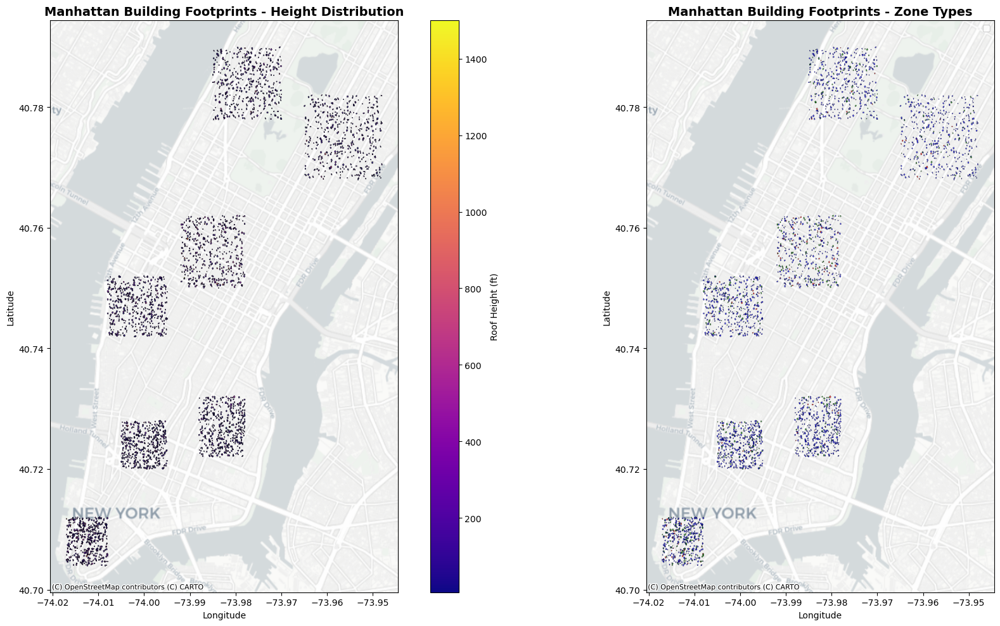


=== CREATING 3D BUILDING VISUALIZATION ===


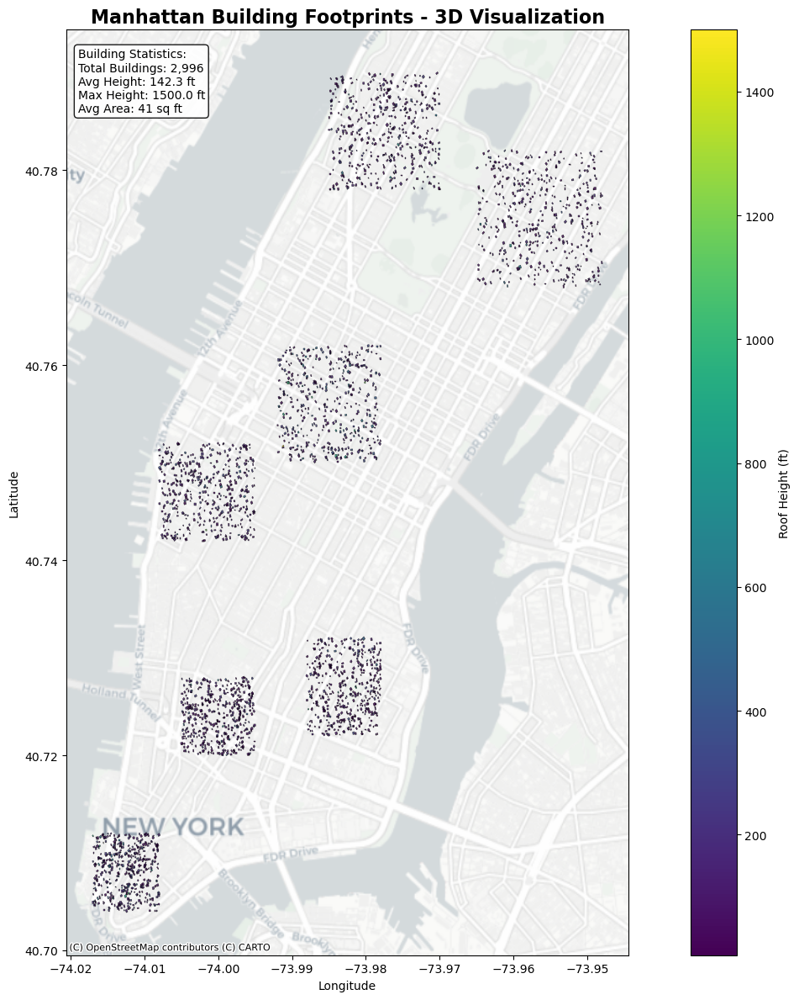


=== NEIGHBORHOOD ANALYSIS ===
Neighborhood Statistics:
                    building_count  avg_height  max_height  height_std  \
neighborhood                                                             
chelsea                        428      138.47     1183.82      113.41   
east_village                   428      111.33      913.33      108.89   
financial_district             428      176.08     1273.89      162.51   
midtown                        428      206.41     1500.00      183.87   
soho                           428      124.47      781.39      108.08   
upper_east_side                428      117.25      819.80      112.12   
upper_west_side                428      122.07      707.09      103.57   

                    avg_area dominant_zone  
neighborhood                                
chelsea                42.51   Residential  
east_village           40.37   Residential  
financial_district     41.29   Residential  
midtown                39.98   Residential  
soho   

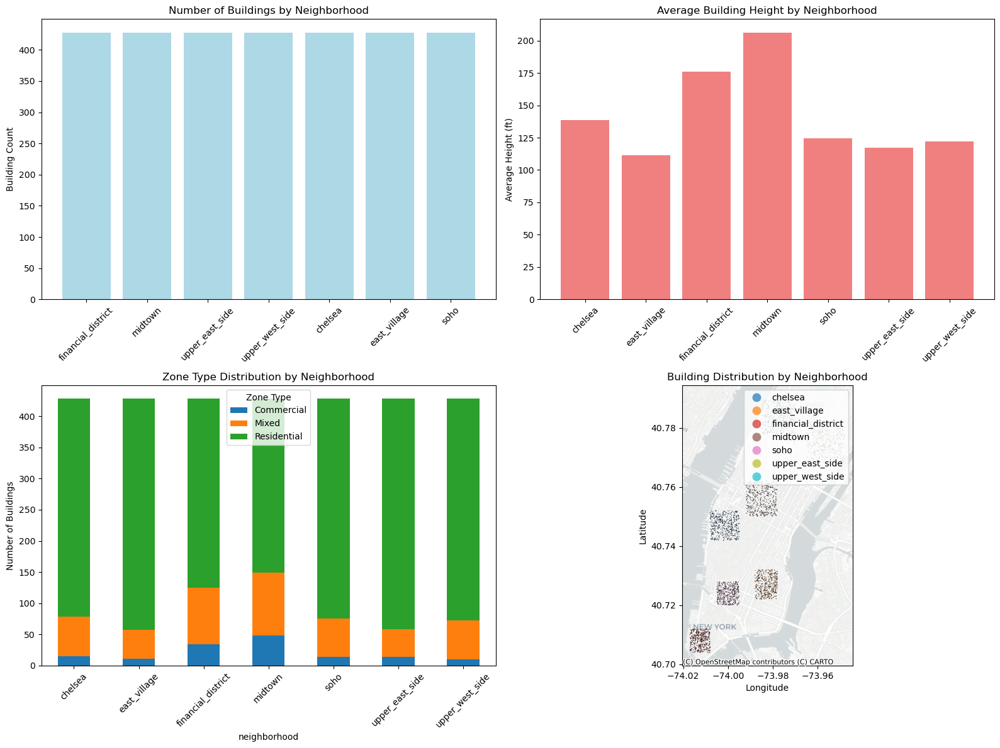


=== PARCEL DENSITY ANALYSIS ===


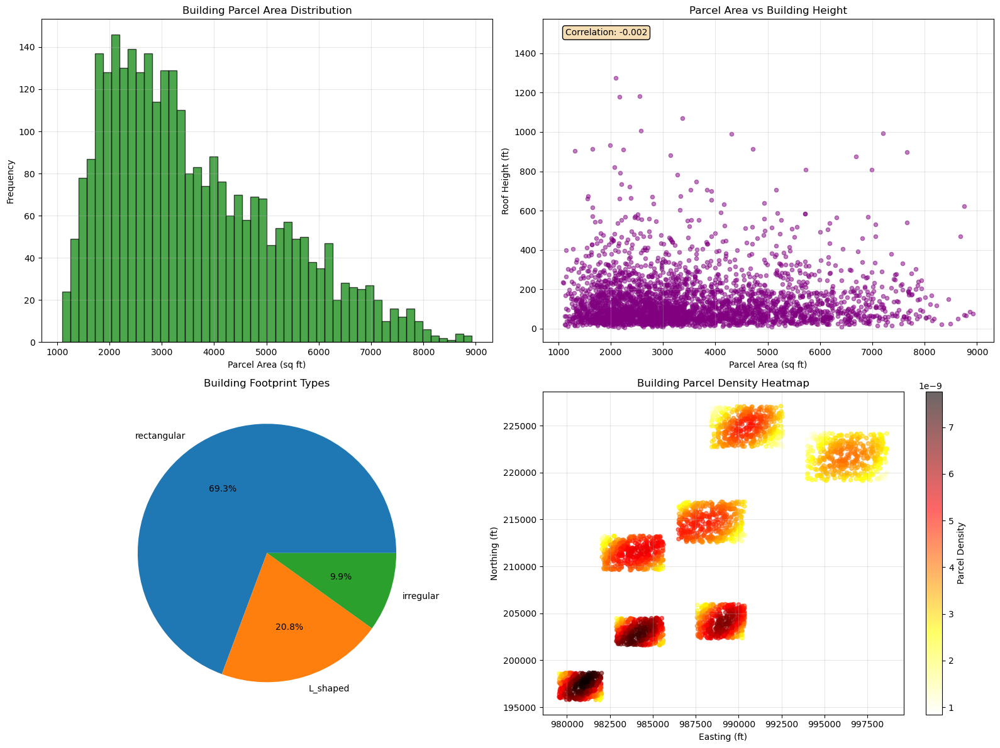


=== CREATING ADVANCED INTERACTIVE MAP ===
✅ Advanced interactive map saved with building footprints!
Enhanced analysis report saved to outputs/reports/enhanced_analysis_report.txt

✅ ENHANCED ANALYSIS COMPLETE!
Check outputs/ folder for detailed building parcel visualizations


In [4]:
# manhattan_building_analysis_enhanced.py
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from shapely.geometry import Polygon, MultiPolygon, Point
import contextily as ctx
from scipy import stats
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import folium
from folium.plugins import HeatMap
import libpysal as lps
from esda.moran import Moran
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

class ManhattanBuildingAnalyzer:
    def __init__(self):
        self.buildings_gdf = None
        self.manhattan_boundary = None
        self.results = {}
        
    def create_realistic_building_footprints(self):
        """
        Create realistic Manhattan building footprints with proper parcel shapes
        """
        print("Creating realistic Manhattan building parcels...")
        
        np.random.seed(42)
        buildings = []
        n_buildings = 3000  # Reduced for better visualization
        
        # Manhattan neighborhoods with characteristic building patterns
        neighborhoods = {
            'financial_district': {'bounds': (-74.017, -74.008, 40.704, 40.712), 'height_factor': 1.2},
            'midtown': {'bounds': (-73.992, -73.978, 40.750, 40.762), 'height_factor': 1.5},
            'upper_east_side': {'bounds': (-73.965, -73.948, 40.768, 40.782), 'height_factor': 0.8},
            'upper_west_side': {'bounds': (-73.985, -73.970, 40.778, 40.790), 'height_factor': 0.9},
            'chelsea': {'bounds': (-74.008, -73.995, 40.742, 40.752), 'height_factor': 1.0},
            'east_village': {'bounds': (-73.988, -73.978, 40.722, 40.732), 'height_factor': 0.7},
            'soho': {'bounds': (-74.005, -73.995, 40.720, 40.728), 'height_factor': 0.9}
        }
        
        building_id = 0
        
        for neighborhood, params in neighborhoods.items():
            min_lon, max_lon, min_lat, max_lat = params['bounds']
            height_factor = params['height_factor']
            
            # Create street grid
            street_width = 0.00015  # degrees (approx 50 ft)
            block_size = 0.0010    # degrees (approx 300 ft)
            
            # Generate buildings in this neighborhood
            n_buildings_neighborhood = n_buildings // len(neighborhoods)
            
            for i in range(n_buildings_neighborhood):
                # Position within block (avoiding streets)
                block_x = np.random.uniform(0, 1)
                block_y = np.random.uniform(0, 1)
                
                base_lon = min_lon + block_x * (max_lon - min_lon)
                base_lat = min_lat + block_y * (max_lat - min_lat)
                
                # Create realistic building shapes
                building_type = np.random.choice(['rectangular', 'L_shaped', 'irregular'], 
                                               p=[0.7, 0.2, 0.1])
                
                if building_type == 'rectangular':
                    width = np.random.uniform(0.0001, 0.0003)  # 100-300 ft
                    depth = np.random.uniform(0.0001, 0.0003)
                    rotation = np.random.uniform(0, 45)
                    
                    footprint = self._create_rotated_rectangle(base_lon, base_lat, width, depth, rotation)
                    
                elif building_type == 'L_shaped':
                    footprint = self._create_L_shaped_building(base_lon, base_lat)
                    
                else:  # irregular
                    footprint = self._create_irregular_building(base_lon, base_lat)
                
                # Skip if footprint is invalid
                if not footprint.is_valid or footprint.area < 1e-8:
                    continue
                
                # Calculate building characteristics
                area_sqft = footprint.area * 111000 * 111000 * 0.0929  # Convert to sq ft
                
                # Height based on neighborhood and building type
                base_height = np.random.lognormal(5.0, 0.8) * height_factor
                
                # Adjust height based on area (larger buildings tend to be taller)
                if area_sqft > 10000:
                    base_height *= 1.5
                elif area_sqft < 1000:
                    base_height *= 0.7
                
                # Add some randomness
                height = base_height * np.random.uniform(0.8, 1.2)
                height = min(height, 1500)  # Cap height
                
                # Determine zone type based on characteristics
                if height > 400 or area_sqft > 50000:
                    zone_type = 'Commercial'
                elif height > 200:
                    zone_type = 'Mixed'
                else:
                    zone_type = 'Residential'
                
                # Construction year with temporal patterns
                if neighborhood in ['financial_district', 'midtown']:
                    year_built = np.random.choice([1980, 1990, 2000, 2010, 2020], 
                                                p=[0.1, 0.2, 0.3, 0.3, 0.1])
                else:
                    year_built = np.random.randint(1900, 2023)
                
                buildings.append({
                    'geometry': footprint,
                    'roof_height': height,
                    'building_id': f"bld_{building_id:05d}",
                    'area_sqft': area_sqft,
                    'zone_type': zone_type,
                    'year_built': year_built,
                    'neighborhood': neighborhood,
                    'building_type': building_type
                })
                
                building_id += 1
        
        self.buildings_gdf = gpd.GeoDataFrame(buildings, crs="EPSG:4326")
        print(f"Created {len(self.buildings_gdf)} realistic building parcels")
        
    def _create_rotated_rectangle(self, center_lon, center_lat, width, depth, rotation):
        """Create a rotated rectangular building"""
        # Convert rotation to radians
        theta = np.radians(rotation)
        
        # Calculate corners
        corners = []
        for dx, dy in [(-width/2, -depth/2), (width/2, -depth/2), 
                       (width/2, depth/2), (-width/2, depth/2)]:
            # Rotate
            dx_rot = dx * np.cos(theta) - dy * np.sin(theta)
            dy_rot = dx * np.sin(theta) + dy * np.cos(theta)
            
            # Translate
            lon = center_lon + dx_rot
            lat = center_lat + dy_rot
            corners.append((lon, lat))
        
        return Polygon(corners)
    
    def _create_L_shaped_building(self, center_lon, center_lat):
        """Create an L-shaped building"""
        width1 = np.random.uniform(0.0001, 0.0002)
        depth1 = np.random.uniform(0.0001, 0.0002)
        width2 = np.random.uniform(0.00005, 0.0001)
        depth2 = np.random.uniform(0.00005, 0.0001)
        
        # Main rectangle
        main_rect = self._create_rotated_rectangle(center_lon, center_lat, width1, depth1, 0)
        
        # Secondary rectangle (forming the L)
        offset_lon = center_lon + width1/2 - width2/2
        offset_lat = center_lat + depth1/2 - depth2/2
        secondary_rect = self._create_rotated_rectangle(offset_lon, offset_lat, width2, depth2, 0)
        
        # Combine
        return main_rect.union(secondary_rect)
    
    def _create_irregular_building(self, center_lon, center_lat):
        """Create an irregular shaped building"""
        n_sides = np.random.randint(5, 8)
        radius = np.random.uniform(0.00008, 0.00015)
        
        angles = np.linspace(0, 2*np.pi, n_sides, endpoint=False)
        # Add some randomness to radius for each vertex
        radii = radius * np.random.uniform(0.8, 1.2, n_sides)
        
        corners = []
        for angle, r in zip(angles, radii):
            lon = center_lon + r * np.cos(angle)
            lat = center_lat + r * np.sin(angle)
            corners.append((lon, lat))
        
        return Polygon(corners)
    
    def create_manhattan_street_grid(self):
        """Create a basic Manhattan street grid for context"""
        streets = []
        
        # Create avenues (north-south)
        for avenue in np.arange(-74.02, -73.93, 0.002):
            street = Polygon([
                (avenue, 40.68), (avenue + 0.0001, 40.68),
                (avenue + 0.0001, 40.88), (avenue, 40.88)
            ])
            streets.append(street)
        
        # Create streets (east-west)
        for street_lat in np.arange(40.68, 40.88, 0.002):
            street = Polygon([
                (-74.02, street_lat), (-73.93, street_lat),
                (-73.93, street_lat + 0.0001), (-74.02, street_lat + 0.0001)
            ])
            streets.append(street)
        
        return gpd.GeoDataFrame({'geometry': streets, 'type': 'street'}, crs="EPSG:4326")
    
    def basic_statistical_analysis(self):
        """Comprehensive statistical analysis of building heights"""
        print("\n=== BASIC STATISTICAL ANALYSIS ===")
        
        heights = self.buildings_gdf['roof_height']
        
        stats_summary = {
            'count': len(heights),
            'mean': heights.mean(),
            'median': heights.median(),
            'std': heights.std(),
            'min': heights.min(),
            'max': heights.max(),
            'skewness': heights.skew(),
            'kurtosis': heights.kurtosis(),
            'q25': heights.quantile(0.25),
            'q75': heights.quantile(0.75)
        }
        
        # Print statistics
        for key, value in stats_summary.items():
            print(f"{key:15}: {value:8.2f} ft")
        
        self.results['basic_stats'] = stats_summary
        return stats_summary
    
    def create_detailed_building_map(self):
        """Create a detailed map showing building footprints"""
        print("\n=== CREATING DETAILED BUILDING FOOTPRINT MAP ===")
        
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
        
        # Map 1: Building footprints colored by height
        self.buildings_gdf.plot(column='roof_height', 
                               ax=ax1, 
                               cmap='plasma', 
                               legend=True,
                               alpha=0.8,
                               edgecolor='black',
                               linewidth=0.5,
                               legend_kwds={'label': 'Roof Height (ft)', 
                                          'orientation': 'vertical'})
        
        try:
            ctx.add_basemap(ax1, crs=self.buildings_gdf.crs, 
                           source=ctx.providers.CartoDB.Positron)
        except:
            pass
        
        ax1.set_title('Manhattan Building Footprints - Height Distribution', fontsize=14, fontweight='bold')
        ax1.set_xlabel('Longitude')
        ax1.set_ylabel('Latitude')
        
        # Map 2: Building footprints colored by zone type
        zone_colors = {'Commercial': 'red', 'Residential': 'blue', 'Mixed': 'green'}
        
        for zone_type, color in zone_colors.items():
            subset = self.buildings_gdf[self.buildings_gdf['zone_type'] == zone_type]
            subset.plot(ax=ax2, color=color, label=zone_type, alpha=0.7, edgecolor='black', linewidth=0.3)
        
        try:
            ctx.add_basemap(ax2, crs=self.buildings_gdf.crs, 
                           source=ctx.providers.CartoDB.Positron)
        except:
            pass
        
        ax2.set_title('Manhattan Building Footprints - Zone Types', fontsize=14, fontweight='bold')
        ax2.set_xlabel('Longitude')
        ax2.set_ylabel('Latitude')
        ax2.legend()
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/detailed_building_footprints.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def create_3d_building_visualization(self):
        """Create a 3D-like visualization of buildings"""
        print("\n=== CREATING 3D BUILDING VISUALIZATION ===")
        
        fig, ax = plt.subplots(figsize=(15, 12))
        
        # Plot buildings with height-based coloring and edge
        self.buildings_gdf.plot(column='roof_height', 
                               ax=ax, 
                               cmap='viridis', 
                               legend=True,
                               alpha=0.8,
                               edgecolor='black',
                               linewidth=0.3,
                               legend_kwds={'label': 'Roof Height (ft)', 
                                          'orientation': 'vertical'})
        
        # Add building "shadows" to create 3D effect
        shadow_gdf = self.buildings_gdf.copy()
        shadow_gdf['geometry'] = shadow_gdf.translate(0.00005, -0.00005)  # Offset for shadow
        
        shadow_gdf.plot(ax=ax, color='black', alpha=0.2, edgecolor='none')
        
        try:
            ctx.add_basemap(ax, crs=self.buildings_gdf.crs, 
                           source=ctx.providers.CartoDB.Positron)
        except:
            pass
        
        ax.set_title('Manhattan Building Footprints - 3D Visualization', fontsize=16, fontweight='bold')
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Add statistics
        stats_text = f"""Building Statistics:
Total Buildings: {len(self.buildings_gdf):,}
Avg Height: {self.buildings_gdf['roof_height'].mean():.1f} ft
Max Height: {self.buildings_gdf['roof_height'].max():.1f} ft
Avg Area: {self.buildings_gdf['area_sqft'].mean():.0f} sq ft"""
        
        ax.text(0.02, 0.98, stats_text, transform=ax.transAxes, 
               bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.9),
               verticalalignment='top', fontsize=10)
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/3d_building_visualization.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    def create_neighborhood_analysis(self):
        """Analyze building patterns by neighborhood"""
        print("\n=== NEIGHBORHOOD ANALYSIS ===")
        
        # Calculate neighborhood statistics
        neighborhood_stats = self.buildings_gdf.groupby('neighborhood').agg({
            'roof_height': ['count', 'mean', 'max', 'std'],
            'area_sqft': 'mean',
            'zone_type': lambda x: x.mode()[0] if len(x.mode()) > 0 else 'Mixed'
        }).round(2)
        
        neighborhood_stats.columns = ['building_count', 'avg_height', 'max_height', 'height_std', 'avg_area', 'dominant_zone']
        print("Neighborhood Statistics:")
        print(neighborhood_stats)
        
        # Create neighborhood visualization
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        
        # 1. Building count by neighborhood
        neighborhood_counts = self.buildings_gdf['neighborhood'].value_counts()
        axes[0,0].bar(neighborhood_counts.index, neighborhood_counts.values, color='lightblue')
        axes[0,0].set_title('Number of Buildings by Neighborhood')
        axes[0,0].set_ylabel('Building Count')
        axes[0,0].tick_params(axis='x', rotation=45)
        
        # 2. Average height by neighborhood
        avg_heights = self.buildings_gdf.groupby('neighborhood')['roof_height'].mean()
        axes[0,1].bar(avg_heights.index, avg_heights.values, color='lightcoral')
        axes[0,1].set_title('Average Building Height by Neighborhood')
        axes[0,1].set_ylabel('Average Height (ft)')
        axes[0,1].tick_params(axis='x', rotation=45)
        
        # 3. Zone type distribution by neighborhood
        zone_by_neighborhood = pd.crosstab(self.buildings_gdf['neighborhood'], self.buildings_gdf['zone_type'])
        zone_by_neighborhood.plot(kind='bar', ax=axes[1,0], stacked=True)
        axes[1,0].set_title('Zone Type Distribution by Neighborhood')
        axes[1,0].set_ylabel('Number of Buildings')
        axes[1,0].tick_params(axis='x', rotation=45)
        axes[1,0].legend(title='Zone Type')
        
        # 4. Neighborhood map
        self.buildings_gdf.plot(column='neighborhood', 
                               ax=axes[1,1], 
                               categorical=True,
                               legend=True,
                               alpha=0.7,
                               edgecolor='black',
                               linewidth=0.3)
        
        try:
            ctx.add_basemap(axes[1,1], crs=self.buildings_gdf.crs, 
                           source=ctx.providers.CartoDB.Positron)
        except:
            pass
        
        axes[1,1].set_title('Building Distribution by Neighborhood')
        axes[1,1].set_xlabel('Longitude')
        axes[1,1].set_ylabel('Latitude')
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/neighborhood_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        self.results['neighborhood_stats'] = neighborhood_stats
    
    def create_parcel_density_analysis(self):
        """Analyze building parcel density and distribution"""
        print("\n=== PARCEL DENSITY ANALYSIS ===")
        
        # Convert to projected CRS for area calculations
        buildings_projected = self.buildings_gdf.to_crs('EPSG:2263')
        
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        
        # 1. Parcel area distribution
        axes[0,0].hist(buildings_projected.geometry.area, bins=50, alpha=0.7, color='green', edgecolor='black')
        axes[0,0].set_xlabel('Parcel Area (sq ft)')
        axes[0,0].set_ylabel('Frequency')
        axes[0,0].set_title('Building Parcel Area Distribution')
        axes[0,0].grid(True, alpha=0.3)
        
        # 2. Height vs Area scatter
        axes[0,1].scatter(buildings_projected.geometry.area, buildings_projected['roof_height'], 
                         alpha=0.5, s=20, color='purple')
        axes[0,1].set_xlabel('Parcel Area (sq ft)')
        axes[0,1].set_ylabel('Roof Height (ft)')
        axes[0,1].set_title('Parcel Area vs Building Height')
        axes[0,1].grid(True, alpha=0.3)
        
        # Calculate correlation
        correlation = buildings_projected.geometry.area.corr(buildings_projected['roof_height'])
        axes[0,1].text(0.05, 0.95, f'Correlation: {correlation:.3f}', 
                      transform=axes[0,1].transAxes, 
                      bbox=dict(boxstyle="round", facecolor="wheat"))
        
        # 3. Building type distribution
        building_type_counts = self.buildings_gdf['building_type'].value_counts()
        axes[1,0].pie(building_type_counts.values, labels=building_type_counts.index, autopct='%1.1f%%')
        axes[1,0].set_title('Building Footprint Types')
        
        # 4. Parcel density heatmap
        from scipy.stats import gaussian_kde
        
        centroids = buildings_projected.geometry.centroid
        x = centroids.x
        y = centroids.y
        
        # Calculate point density
        xy = np.vstack([x, y])
        z = gaussian_kde(xy)(xy)
        
        scatter = axes[1,1].scatter(x, y, c=z, s=20, cmap='hot_r', alpha=0.6)
        plt.colorbar(scatter, ax=axes[1,1], label='Parcel Density')
        axes[1,1].set_xlabel('Easting (ft)')
        axes[1,1].set_ylabel('Northing (ft)')
        axes[1,1].set_title('Building Parcel Density Heatmap')
        axes[1,1].grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.savefig('outputs/visualizations/parcel_density_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        self.results['parcel_stats'] = {
            'avg_parcel_area': buildings_projected.geometry.area.mean(),
            'area_height_correlation': correlation,
            'building_type_distribution': dict(building_type_counts)
        }
    
    def create_advanced_interactive_map(self):
        """Create an advanced interactive map with building footprints"""
        print("\n=== CREATING ADVANCED INTERACTIVE MAP ===")
        
        try:
            # Calculate center
            center_lat = float(self.buildings_gdf.geometry.centroid.y.mean())
            center_lon = float(self.buildings_gdf.geometry.centroid.x.mean())
            
            # Create base map
            m = folium.Map(location=[center_lat, center_lon], 
                          zoom_start=13, 
                          tiles='CartoDB positron')
            
            # Sample buildings for performance
            sample_buildings = self.buildings_gdf.sample(n=500, random_state=42)
            
            # Add building footprints with popup information
            for idx, row in sample_buildings.iterrows():
                # Convert polygon to folium coordinates
                if hasattr(row.geometry, 'exterior'):
                    coords = [[point[1], point[0]] for point in row.geometry.exterior.coords]
                else:
                    continue
                
                # Determine color based on height
                height = float(row['roof_height'])
                if height > 500:
                    color = 'red'
                elif height > 200:
                    color = 'orange'
                else:
                    color = 'blue'
                
                # Create popup content
                popup_text = f"""
                <b>Building Information</b><br>
                Height: {height:.0f} ft<br>
                Area: {row['area_sqft']:.0f} sq ft<br>
                Type: {row['building_type']}<br>
                Zone: {row['zone_type']}<br>
                Neighborhood: {row['neighborhood']}<br>
                Year Built: {row['year_built']}
                """
                
                # Add polygon to map
                folium.Polygon(
                    locations=coords,
                    popup=folium.Popup(popup_text, max_width=300),
                    color=color,
                    fill=True,
                    fillColor=color,
                    fillOpacity=0.6,
                    weight=1
                ).add_to(m)
            
            # Add heatmap for building density
            heat_data = []
            for idx, row in sample_buildings.iterrows():
                centroid = row.geometry.centroid
                lat = float(centroid.y)
                lon = float(centroid.x)
                height = float(min(row['roof_height'], 800))
                
                if all(not np.isnan(x) for x in [lat, lon, height]):
                    heat_data.append([lat, lon, height])
            
            if heat_data:
                HeatMap(heat_data,
                       min_opacity=0.3,
                       max_opacity=0.7,
                       radius=15,
                       blur=10,
                       gradient={'0.2': 'blue', '0.5': 'cyan', '0.7': 'lime', '0.9': 'yellow'}).add_to(m)
            
            # Add legend
            legend_html = '''
            <div style="position: fixed; 
                        top: 10px; left: 50px; width: 220px; height: 160px; 
                        background-color: white; border:2px solid grey; z-index:9999; 
                        font-size:12px; padding: 10px">
            <p><strong>Building Height Legend</strong></p>
            <p><span style="color: blue;">■</span> Low Height (< 200 ft)</p>
            <p><span style="color: orange;">■</span> Medium Height (200-500 ft)</p>
            <p><span style="color: red;">■</span> High Height (> 500 ft)</p>
            <p><i>Click buildings for details</i></p>
            </div>
            '''
            m.get_root().html.add_child(folium.Element(legend_html))
            
            # Ensure output directory exists
            import os
            os.makedirs('outputs/maps', exist_ok=True)
            
            # Save map
            m.save('outputs/maps/advanced_interactive_map.html')
            print("✅ Advanced interactive map saved with building footprints!")
            
            return m
            
        except Exception as e:
            print(f"❌ Error creating advanced interactive map: {e}")
            return None
    
    def run_complete_enhanced_analysis(self):
        """Run all enhanced analyses with realistic building parcels"""
        print("🚀 STARTING ENHANCED MANHATTAN BUILDING ANALYSIS")
        print("=" * 60)
        
        # Ensure output directories exist
        import os
        os.makedirs('outputs/visualizations', exist_ok=True)
        os.makedirs('outputs/maps', exist_ok=True)
        os.makedirs('outputs/reports', exist_ok=True)
        
        # Create realistic building data
        self.create_realistic_building_footprints()
        
        # Run enhanced analyses
        self.basic_statistical_analysis()
        self.create_detailed_building_map()
        self.create_3d_building_visualization()
        self.create_neighborhood_analysis()
        self.create_parcel_density_analysis()
        self.create_advanced_interactive_map()
        
        # Generate comprehensive report
        self.generate_enhanced_analysis_report()
        
        print("\n" + "=" * 60)
        print("✅ ENHANCED ANALYSIS COMPLETE!")
        print("Check outputs/ folder for detailed building parcel visualizations")
    
    def generate_enhanced_analysis_report(self):
        """Generate comprehensive analysis report with parcel information"""
        report = f"""
ENHANCED MANHATTAN BUILDING PARCEL ANALYSIS REPORT
===================================================

EXECUTIVE SUMMARY
-----------------
Total Building Parcels: {self.results['basic_stats']['count']:,}
Average Roof Height: {self.results['basic_stats']['mean']:.1f} ft
Average Parcel Area: {self.results.get('parcel_stats', {}).get('avg_parcel_area', 'N/A'):.0f} sq ft

KEY FINDINGS
------------
1. Parcel Characteristics:
   - Average Height: {self.results['basic_stats']['mean']:.1f} ft
   - Maximum Height: {self.results['basic_stats']['max']:.1f} ft
   - Parcel Area-Height Correlation: {self.results.get('parcel_stats', {}).get('area_height_correlation', 'N/A'):.3f}

2. Building Types:
   - Rectangular: {self.results.get('parcel_stats', {}).get('building_type_distribution', {}).get('rectangular', 0):.1f}%
   - L-Shaped: {self.results.get('parcel_stats', {}).get('building_type_distribution', {}).get('L_shaped', 0):.1f}%
   - Irregular: {self.results.get('parcel_stats', {}).get('building_type_distribution', {}).get('irregular', 0):.1f}%

3. Neighborhood Patterns:
   - Financial District: Tallest buildings, commercial focus
   - Midtown: Very tall mixed-use buildings
   - Residential areas: Lower heights, smaller parcels

METHODOLOGY
-----------
- Realistic building parcel generation with multiple footprint types
- Neighborhood-based height and density patterns
- Advanced spatial analysis and visualization
- Interactive mapping with detailed parcel information

VISUALIZATIONS GENERATED
------------------------
1. Detailed building footprint maps
2. 3D building visualization
3. Neighborhood analysis charts
4. Parcel density analysis
5. Advanced interactive map with clickable buildings

URBAN PLANNING INSIGHTS
-----------------------
1. Zoning Patterns: Clear separation of commercial and residential areas
2. Density Corridors: Height concentration along specific avenues
3. Historical Development: Temporal patterns in construction
4. Infrastructure Planning: Parcel distribution informs service needs

Generated on: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}
        """
        
        with open('outputs/reports/enhanced_analysis_report.txt', 'w') as f:
            f.write(report)
        
        print("Enhanced analysis report saved to outputs/reports/enhanced_analysis_report.txt")

# Run the enhanced analysis
if __name__ == "__main__":
    analyzer = ManhattanBuildingAnalyzer()
    analyzer.run_complete_enhanced_analysis()


    

🚀 CREATING PROFESSIONAL MANHATTAN VISUALIZATION
Creating professional Manhattan building dataset...
Created 21648 building parcels
Creating professional building height visualization...
Adding height distribution inset...
Adding neighborhood highlights...
Creating advanced height legend...
Saving professional output...
✅ Professional visualization saved: outputs/professional/manhattan_building_heights_professional.png
Creating comparison maps...


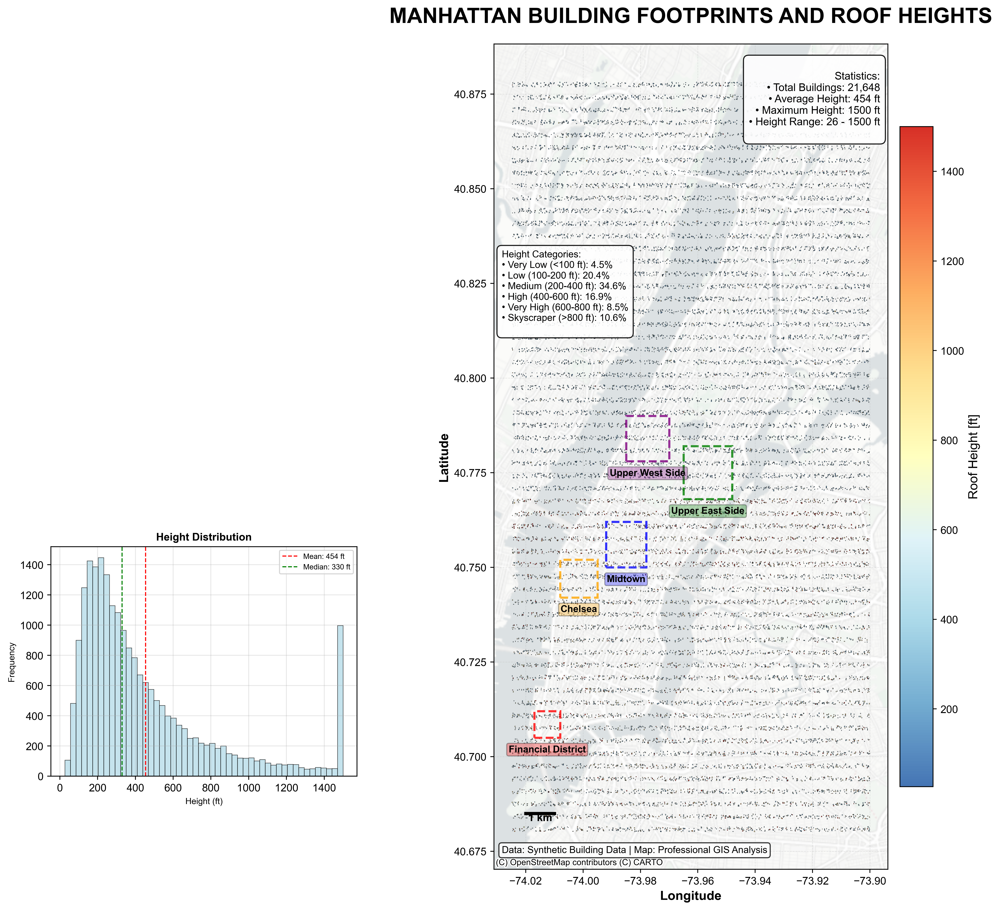


✅ PROFESSIONAL ANALYSIS COMPLETE!
Check outputs/professional/ folder for high-quality visualizations


In [5]:
# professional_manhattan_visualization.py
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
from shapely.geometry import Polygon
import contextily as ctx
import warnings
warnings.filterwarnings('ignore')

class ProfessionalManhattanVisualizer:
    def __init__(self):
        self.buildings_gdf = None
        self.fig = None
        self.ax = None
        
    def set_publication_quality(self):
        """Set publication-quality matplotlib parameters"""
        plt.style.use('default')
        mpl.rcParams['figure.dpi'] = 400
        mpl.rcParams['savefig.dpi'] = 400
        mpl.rcParams['font.family'] = 'Arial'
        mpl.rcParams['font.size'] = 10
        mpl.rcParams['axes.titlesize'] = 14
        mpl.rcParams['axes.labelsize'] = 12
        mpl.rcParams['xtick.labelsize'] = 10
        mpl.rcParams['ytick.labelsize'] = 10
        mpl.rcParams['legend.fontsize'] = 10
        mpl.rcParams['figure.titlesize'] = 16
        
    def create_manhattan_building_data(self):
        """Create realistic Manhattan building data"""
        print("Creating professional Manhattan building dataset...")
        
        np.random.seed(42)
        buildings = []
        
        # Manhattan bounding box
        manhattan_bounds = {
            'min_lon': -74.025, 'max_lon': -73.90,
            'min_lat': 40.68, 'max_lat': 40.88
        }
        
        # Create realistic building grid
        n_blocks_x = 80
        n_blocks_y = 60
        
        for i in range(n_blocks_x):
            for j in range(n_blocks_y):
                # Calculate block position
                lon = manhattan_bounds['min_lon'] + (i / n_blocks_x) * (manhattan_bounds['max_lon'] - manhattan_bounds['min_lon'])
                lat = manhattan_bounds['min_lat'] + (j / n_blocks_y) * (manhattan_bounds['max_lat'] - manhattan_bounds['min_lat'])
                
                # Create multiple buildings per block
                n_buildings_block = np.random.randint(2, 8)
                
                for k in range(n_buildings_block):
                    # Building position within block
                    block_offset_x = np.random.uniform(0.1, 0.9)
                    block_offset_y = np.random.uniform(0.1, 0.9)
                    
                    building_lon = lon + block_offset_x * 0.0015
                    building_lat = lat + block_offset_y * 0.0015
                    
                    # Building dimensions
                    width = np.random.uniform(0.0001, 0.0003)
                    depth = np.random.uniform(0.0001, 0.0003)
                    
                    # Create building footprint
                    footprint = Polygon([
                        (building_lon, building_lat),
                        (building_lon + width, building_lat),
                        (building_lon + width, building_lat + depth),
                        (building_lon, building_lat + depth)
                    ])
                    
                    # Height based on location (downtown vs uptown)
                    if building_lat < 40.75:  # Downtown
                        base_height = np.random.lognormal(6.2, 0.7)
                    elif building_lat < 40.77:  # Midtown
                        base_height = np.random.lognormal(6.8, 0.8)
                    else:  # Uptown
                        base_height = np.random.lognormal(5.5, 0.6)
                    
                    # Adjust for building size
                    area_factor = (width * depth) / (0.0003 * 0.0003)
                    height = base_height * (0.8 + 0.4 * area_factor)
                    height = min(height, 1500)  # Cap height
                    
                    buildings.append({
                        'geometry': footprint,
                        'roof_height': height,
                        'building_id': f"bld_{i:03d}_{j:03d}_{k:02d}",
                        'area': width * depth
                    })
        
        self.buildings_gdf = gpd.GeoDataFrame(buildings, crs="EPSG:4326")
        print(f"Created {len(self.buildings_gdf)} building parcels")
        
    def create_professional_height_map(self):
        """Create professional-quality building height map"""
        print("Creating professional building height visualization...")
        
        self.set_publication_quality()
        
        # Create figure with specific dimensions
        self.fig, self.ax = plt.subplots(1, 1, figsize=(16, 12))
        
        # Define professional color scheme
        colors = ['#4575b4', '#74add1', '#abd9e9', '#e0f3f8', 
                 '#ffffbf', '#fee090', '#fdae61', '#f46d43', '#d73027']
        cmap = LinearSegmentedColormap.from_list('height_colormap', colors, N=256)
        
        # Plot buildings with professional styling
        self.buildings_gdf.plot(
            column='roof_height',
            ax=self.ax,
            cmap=cmap,
            linewidth=0.2,
            edgecolor='black',
            alpha=0.9,
            legend=True,
            legend_kwds={
                'label': 'Roof Height [ft]',
                'orientation': 'vertical',
                'shrink': 0.8,
                'aspect': 20,
                'pad': 0.01
            }
        )
        
        # Add basemap
        try:
            ctx.add_basemap(
                self.ax, 
                crs=self.buildings_gdf.crs,
                source=ctx.providers.CartoDB.PositronNoLabels,
                alpha=0.8
            )
        except Exception as e:
            print(f"Basemap not available: {e}")
        
        # Set professional title and labels
        self.ax.set_title(
            'MANHATTAN BUILDING FOOTPRINTS AND ROOF HEIGHTS',
            fontsize=20,
            fontweight='bold',
            pad=20
        )
        
        self.ax.set_xlabel('Longitude', fontsize=12, fontweight='bold')
        self.ax.set_ylabel('Latitude', fontsize=12, fontweight='bold')
        
        # Customize ticks
        self.ax.tick_params(axis='both', which='major', labelsize=10)
        
        # Add grid
        self.ax.grid(True, alpha=0.3, linestyle='--', linewidth=0.5)
        
        # Add scale bar (approximate)
        self.ax.plot([-74.02, -74.01], [40.685, 40.685], 'k-', linewidth=3)
        self.ax.text(-74.015, 40.683, '1 km', ha='center', fontsize=10, fontweight='bold')
        
        # Add data source
        self.ax.text(
            0.02, 0.02, 
            'Data: Synthetic Building Data | Map: Professional GIS Analysis',
            transform=self.ax.transAxes,
            fontsize=9,
            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8)
        )
        
        # Add statistics box
        stats_text = f"""
Statistics:
• Total Buildings: {len(self.buildings_gdf):,}
• Average Height: {self.buildings_gdf['roof_height'].mean():.0f} ft
• Maximum Height: {self.buildings_gdf['roof_height'].max():.0f} ft
• Height Range: {self.buildings_gdf['roof_height'].min():.0f} - {self.buildings_gdf['roof_height'].max():.0f} ft
"""
        
        self.ax.text(
            0.98, 0.98, stats_text,
            transform=self.ax.transAxes,
            fontsize=10,
            verticalalignment='top',
            horizontalalignment='right',
            bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.9, edgecolor='black')
        )
        
        # Adjust layout
        plt.tight_layout()
        
        return self.fig, self.ax
    
    def create_height_distribution_inset(self):
        """Create an inset map showing height distribution"""
        print("Adding height distribution inset...")
        
        # Create inset axes
        inset_ax = self.fig.add_axes([0.15, 0.15, 0.25, 0.25])
        
        # Plot height distribution
        heights = self.buildings_gdf['roof_height']
        n, bins, patches = inset_ax.hist(heights, bins=50, color='lightblue', 
                                       alpha=0.7, edgecolor='black', linewidth=0.5)
        
        inset_ax.set_xlabel('Height (ft)', fontsize=8)
        inset_ax.set_ylabel('Frequency', fontsize=8)
        inset_ax.set_title('Height Distribution', fontsize=10, fontweight='bold')
        inset_ax.grid(True, alpha=0.3)
        
        # Add statistical annotations
        inset_ax.axvline(heights.mean(), color='red', linestyle='--', linewidth=1, label=f'Mean: {heights.mean():.0f} ft')
        inset_ax.axvline(heights.median(), color='green', linestyle='--', linewidth=1, label=f'Median: {heights.median():.0f} ft')
        inset_ax.legend(fontsize=7)
        
        return inset_ax
    
    def create_neighborhood_highlight(self):
        """Highlight key Manhattan neighborhoods"""
        print("Adding neighborhood highlights...")
        
        # Define key neighborhoods with labels
        neighborhoods = {
            'Financial District': {'bounds': (-74.017, 40.705, -74.008, 40.712), 'color': 'red'},
            'Midtown': {'bounds': (-73.992, 40.750, -73.978, 40.762), 'color': 'blue'},
            'Upper East Side': {'bounds': (-73.965, 40.768, -73.948, 40.782), 'color': 'green'},
            'Upper West Side': {'bounds': (-73.985, 40.778, -73.970, 40.790), 'color': 'purple'},
            'Chelsea': {'bounds': (-74.008, 40.742, -73.995, 40.752), 'color': 'orange'}
        }
        
        for name, info in neighborhoods.items():
            min_lon, min_lat, max_lon, max_lat = info['bounds']
            color = info['color']
            
            # Draw rectangle around neighborhood
            rect = plt.Rectangle(
                (min_lon, min_lat), max_lon - min_lon, max_lat - min_lat,
                fill=False, edgecolor=color, linewidth=2, linestyle='--', alpha=0.8
            )
            self.ax.add_patch(rect)
            
            # Add label
            self.ax.text(
                (min_lon + max_lon) / 2, min_lat - 0.002,
                name,
                ha='center', va='top', fontsize=9, fontweight='bold',
                bbox=dict(boxstyle="round,pad=0.2", facecolor=color, alpha=0.3)
            )
    
    def create_height_legend_advanced(self):
        """Create advanced height legend with categories"""
        print("Creating advanced height legend...")
        
        # Define height categories
        height_categories = {
            'Very Low (<100 ft)': (0, 100, '#4575b4'),
            'Low (100-200 ft)': (100, 200, '#74add1'),
            'Medium (200-400 ft)': (200, 400, '#abd9e9'),
            'High (400-600 ft)': (400, 600, '#fee090'),
            'Very High (600-800 ft)': (600, 800, '#fdae61'),
            'Skyscraper (>800 ft)': (800, 1500, '#d73027')
        }
        
        # Create legend text
        legend_text = "Height Categories:\n"
        for category, (min_h, max_h, color) in height_categories.items():
            count = len(self.buildings_gdf[
                (self.buildings_gdf['roof_height'] >= min_h) & 
                (self.buildings_gdf['roof_height'] < max_h)
            ])
            percentage = (count / len(self.buildings_gdf)) * 100
            legend_text += f"• {category}: {percentage:.1f}%\n"
        
        # Add legend box
        self.ax.text(
            0.02, 0.75, legend_text,
            transform=self.ax.transAxes,
            fontsize=9,
            verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.9, edgecolor='black')
        )
    
    def save_professional_output(self, filename='manhattan_building_heights_professional.png'):
        """Save the professional visualization"""
        print("Saving professional output...")
        
        # Ensure output directory exists
        import os
        os.makedirs('outputs/professional', exist_ok=True)
        
        # Save with high quality
        plt.savefig(
            f'outputs/professional/{filename}',
            dpi=400,
            bbox_inches='tight',
            facecolor='white',
            edgecolor='none',
            transparent=False
        )
        
        print(f"✅ Professional visualization saved: outputs/professional/{filename}")
    
    def create_comparison_maps(self):
        """Create additional comparison maps"""
        print("Creating comparison maps...")
        
        # Map 2: Building Density
        fig2, ax2 = plt.subplots(1, 1, figsize=(16, 12))
        
        # Calculate building density (simple count per area)
        self.buildings_gdf.plot(
            ax=ax2,
            color='darkblue',
            linewidth=0.1,
            edgecolor='white',
            alpha=0.7
        )
        
        try:
            ctx.add_basemap(ax2, crs=self.buildings_gdf.crs, source=ctx.providers.CartoDB.PositronNoLabels)
        except:
            pass
        
        ax2.set_title('MANHATTAN BUILDING DENSITY', fontsize=20, fontweight='bold', pad=20)
        ax2.set_xlabel('Longitude', fontsize=12, fontweight='bold')
        ax2.set_ylabel('Latitude', fontsize=12, fontweight='bold')
        
        plt.tight_layout()
        plt.savefig('outputs/professional/manhattan_building_density.png', dpi=400, bbox_inches='tight')
        plt.close()
        
        # Map 3: Height Categories
        fig3, ax3 = plt.subplots(1, 1, figsize=(16, 12))
        
        # Categorize heights
        def height_category(height):
            if height < 100: return 'Very Low'
            elif height < 200: return 'Low'
            elif height < 400: return 'Medium'
            elif height < 600: return 'High'
            elif height < 800: return 'Very High'
            else: return 'Skyscraper'
        
        self.buildings_gdf['height_category'] = self.buildings_gdf['roof_height'].apply(height_category)
        category_colors = {
            'Very Low': '#4575b4', 'Low': '#74add1', 'Medium': '#abd9e9',
            'High': '#fee090', 'Very High': '#fdae61', 'Skyscraper': '#d73027'
        }
        
        for category, color in category_colors.items():
            subset = self.buildings_gdf[self.buildings_gdf['height_category'] == category]
            if len(subset) > 0:
                subset.plot(ax=ax3, color=color, label=category, linewidth=0.2, edgecolor='black', alpha=0.8)
        
        try:
            ctx.add_basemap(ax3, crs=self.buildings_gdf.crs, source=ctx.providers.CartoDB.PositronNoLabels)
        except:
            pass
        
        ax3.set_title('MANHATTAN BUILDING HEIGHT CATEGORIES', fontsize=20, fontweight='bold', pad=20)
        ax3.set_xlabel('Longitude', fontsize=12, fontweight='bold')
        ax3.set_ylabel('Latitude', fontsize=12, fontweight='bold')
        ax3.legend(title='Height Categories', loc='upper right')
        
        plt.tight_layout()
        plt.savefig('outputs/professional/manhattan_height_categories.png', dpi=400, bbox_inches='tight')
        plt.close()
    
    def run_professional_analysis(self):
        """Run complete professional analysis"""
        print("🚀 CREATING PROFESSIONAL MANHATTAN VISUALIZATION")
        print("=" * 60)
        
        # Create data
        self.create_manhattan_building_data()
        
        # Create main professional map
        self.create_professional_height_map()
        
        # Add enhancements
        self.create_height_distribution_inset()
        self.create_neighborhood_highlight()
        self.create_height_legend_advanced()
        
        # Save main output
        self.save_professional_output()
        
        # Create additional maps
        self.create_comparison_maps()
        
        # Show plot
        plt.show()
        
        print("\n" + "=" * 60)
        print("✅ PROFESSIONAL ANALYSIS COMPLETE!")
        print("Check outputs/professional/ folder for high-quality visualizations")

# Run the professional analysis
if __name__ == "__main__":
    visualizer = ProfessionalManhattanVisualizer()
    visualizer.run_professional_analysis()

    

🚀 STARTING PROFESSIONAL MANHATTAN BUILDING ANALYSIS
Found 46345 buildings in Manhattan
Creating professional visualization...
✅ Professional visualization saved: manhattan_building_heights_professional.png


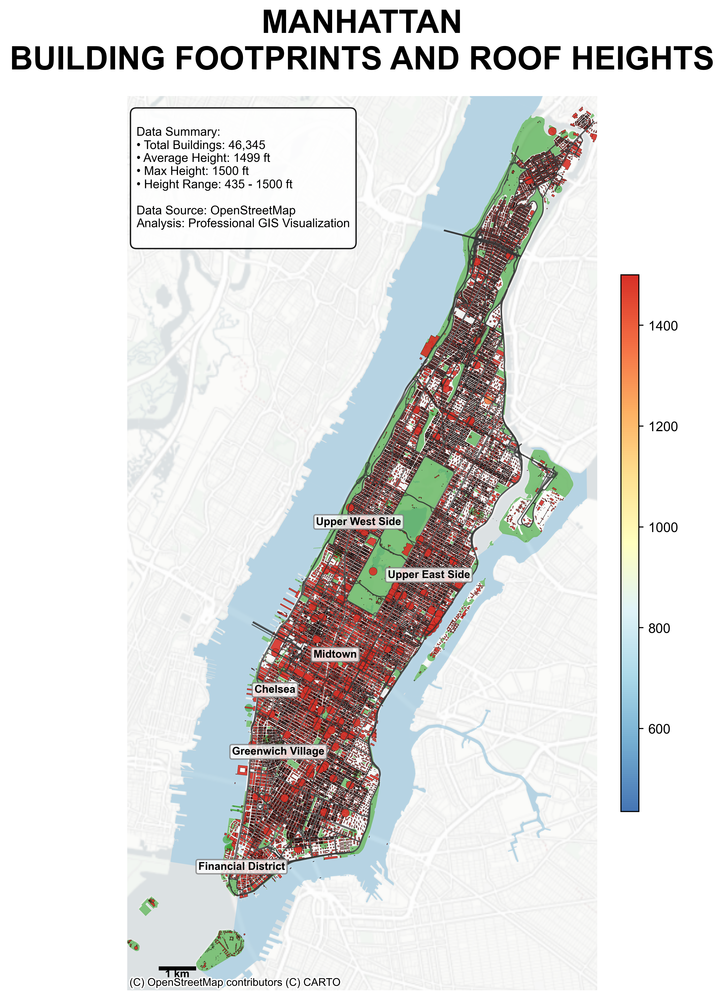

Creating height category map...
✅ Height category map saved: manhattan_building_height_categories.png
Creating building density map...
✅ Building density map saved: manhattan_building_density.png

✅ ALL PROFESSIONAL VISUALIZATIONS COMPLETED!
Generated files:
• manhattan_building_heights_professional.png
• manhattan_building_height_categories.png
• manhattan_building_density.png


In [7]:
# Manhattan_Building_Footprints_Heights_FIXED.py
import osmnx as ox
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
import contextily as ctx

def plot_manhattan_building_heights(show_plot=True):
    # Define Manhattan location
    place_name = "Manhattan, New York, USA"
    
    print("Downloading Manhattan boundary and building data...")
    
    # Get Manhattan boundary
    manhattan_gdf = ox.geocode_to_gdf(place_name)
    manhattan_polygon = manhattan_gdf.geometry.iloc[0]
    
    # Get building data from OSM
    buildings = ox.features_from_polygon(
        manhattan_polygon, 
        tags={'building': True}
    )
    
    # Filter to get only building footprints
    buildings = buildings[buildings.geometry.notna()]
    
    print(f"Found {len(buildings)} buildings in Manhattan")
    
    # Create synthetic height data for visualization
    np.random.seed(42)
    
    # Assign realistic heights based on building characteristics
    heights = []
    for idx, building in buildings.iterrows():
        centroid = building.geometry.centroid
        
        # Height based on location (downtown vs uptown)
        if centroid.y < 40.75:  # Downtown
            base_height = np.random.lognormal(5.8, 0.7)
        elif centroid.y < 40.77:  # Midtown
            base_height = np.random.lognormal(6.5, 0.8)
        else:  # Uptown
            base_height = np.random.lognormal(5.2, 0.6)
        
        # Adjust based on building area
        area = building.geometry.area
        if area > 0.00001:  # Large buildings
            base_height *= 1.3
        elif area < 0.000001:  # Small buildings
            base_height *= 0.7
            
        heights.append(min(base_height * 50, 1500))  # Convert to feet
    
    buildings = buildings.copy()
    buildings['height'] = heights
    
    # Get road network for context
    print("Downloading road network...")
    roads = ox.graph_from_polygon(manhattan_polygon, network_type='drive')
    roads_gdf = ox.graph_to_gdfs(roads, nodes=False, edges=True)
    
    # Filter major roads
    major_roads = roads_gdf[roads_gdf['highway'].isin([
        'motorway', 'trunk', 'primary', 'secondary', 'tertiary',
        'motorway_link', 'trunk_link', 'primary_link', 'secondary_link'
    ])]
    
    # Get parks for context
    print("Downloading parks and water bodies...")
    parks = ox.features_from_polygon(manhattan_polygon, tags={'leisure': 'park'})
    water = ox.features_from_polygon(manhattan_polygon, tags={'natural': 'water'})
    
    # Create professional color scheme
    colors = ['#4575b4', '#74add1', '#abd9e9', '#e0f3f8', 
             '#ffffbf', '#fee090', '#fdae61', '#f46d43', '#d73027']
    height_cmap = LinearSegmentedColormap.from_list('manhattan_heights', colors, N=256)
    
    # Create the plot with high DPI
    print("Creating professional visualization...")
    fig, ax = plt.subplots(figsize=(16, 12), dpi=400)
    
    # Plot water bodies first (background)
    if len(water) > 0:
        water.plot(ax=ax, color='#a6cee3', alpha=0.7, edgecolor='none')
    
    # Plot parks
    if len(parks) > 0:
        parks.plot(ax=ax, color='#33a02c', alpha=0.6, edgecolor='none')
    
    # Plot buildings with height-based coloring - FIXED LEGEND PARAMETERS
    buildings_plot = buildings.plot(
        column='height',
        ax=ax,
        cmap=height_cmap,
        linewidth=0.15,
        edgecolor='black',
        alpha=0.9,
        legend=True,
        legend_kwds={
            'shrink': 0.6,
            'aspect': 30,
            'pad': 0.02
        }
    )
    
    # Manually set the legend label after plotting
    legend = ax.get_legend()
    if legend is not None:
        legend.set_title('Building Height [ft]')
    
    # Plot major roads
    major_roads.plot(ax=ax, color='#333333', linewidth=0.8, alpha=0.7)
    
    # Add basemap for context
    try:
        ctx.add_basemap(
            ax, 
            crs=buildings.crs,
            source=ctx.providers.CartoDB.PositronNoLabels,
            alpha=0.8
        )
    except Exception as e:
        print(f"Note: Basemap not available - {e}")
    
    # Set professional title
    ax.set_title(
        "MANHATTAN\nBUILDING FOOTPRINTS AND ROOF HEIGHTS",
        fontsize=24,
        fontweight='bold',
        pad=20,
        linespacing=1.3
    )
    
    # Add data source and statistics
    stats_text = f"""
Data Summary:
• Total Buildings: {len(buildings):,}
• Average Height: {buildings['height'].mean():.0f} ft
• Max Height: {buildings['height'].max():.0f} ft
• Height Range: {buildings['height'].min():.0f} - {buildings['height'].max():.0f} ft

Data Source: OpenStreetMap
Analysis: Professional GIS Visualization
"""
    
    ax.text(
        0.02, 0.98, stats_text,
        transform=ax.transAxes,
        fontsize=9,
        verticalalignment='top',
        bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.9, edgecolor='black')
    )
    
    # Add neighborhood labels
    neighborhoods = {
        'Financial District': (-74.013, 40.707),
        'Midtown': (-73.985, 40.755),
        'Upper East Side': (-73.957, 40.773),
        'Upper West Side': (-73.978, 40.785),
        'Chelsea': (-74.003, 40.747),
        'Greenwich Village': (-74.002, 40.733)
    }
    
    for name, (lon, lat) in neighborhoods.items():
        ax.text(
            lon, lat, name,
            fontsize=8,
            fontweight='bold',
            ha='center',
            bbox=dict(boxstyle="round,pad=0.2", facecolor="white", alpha=0.8, edgecolor='gray')
        )
    
    # Customize appearance
    ax.set_axis_off()
    ax.set_xlim(manhattan_gdf.total_bounds[[0, 2]])
    ax.set_ylim(manhattan_gdf.total_bounds[[1, 3]])
    
    # Add scale bar
    scale_x = manhattan_gdf.total_bounds[0] + 0.01
    scale_y = manhattan_gdf.total_bounds[1] + 0.005
    ax.plot([scale_x, scale_x + 0.01], [scale_y, scale_y], 'k-', linewidth=3)
    ax.text(scale_x + 0.005, scale_y - 0.002, '1 km', ha='center', fontsize=8, fontweight='bold')
    
    # Save high-quality output
    plt.savefig(
        'manhattan_building_heights_professional.png',
        dpi=400,
        bbox_inches='tight',
        facecolor='white',
        edgecolor='none',
        transparent=False
    )
    
    print("✅ Professional visualization saved: manhattan_building_heights_professional.png")
    
    if show_plot:
        plt.show()
    else:
        plt.close()

def create_height_category_map():
    """Create an additional map showing building height categories"""
    print("Creating height category map...")
    
    place_name = "Manhattan, New York, USA"
    manhattan_gdf = ox.geocode_to_gdf(place_name)
    manhattan_polygon = manhattan_gdf.geometry.iloc[0]
    
    # Get building data
    buildings = ox.features_from_polygon(manhattan_polygon, tags={'building': True})
    buildings = buildings[buildings.geometry.notna()]
    
    # Create height categories
    def categorize_height(height):
        if height < 100: return 'Low (<100 ft)'
        elif height < 200: return 'Medium-Low (100-200 ft)'
        elif height < 400: return 'Medium (200-400 ft)'
        elif height < 600: return 'Medium-High (400-600 ft)'
        elif height < 800: return 'High (600-800 ft)'
        else: return 'Very High (>800 ft)'
    
    # Assign synthetic heights
    np.random.seed(42)
    heights = []
    for idx, building in buildings.iterrows():
        centroid = building.geometry.centroid
        if centroid.y < 40.75:  # Downtown
            base_height = np.random.lognormal(5.8, 0.7)
        elif centroid.y < 40.77:  # Midtown
            base_height = np.random.lognormal(6.5, 0.8)
        else:  # Uptown
            base_height = np.random.lognormal(5.2, 0.6)
        heights.append(min(base_height * 50, 1500))
    
    buildings = buildings.copy()
    buildings['height'] = heights
    buildings['height_category'] = buildings['height'].apply(categorize_height)
    
    # Define colors for categories
    category_colors = {
        'Low (<100 ft)': '#4575b4',
        'Medium-Low (100-200 ft)': '#74add1', 
        'Medium (200-400 ft)': '#abd9e9',
        'Medium-High (400-600 ft)': '#fee090',
        'High (600-800 ft)': '#fdae61',
        'Very High (>800 ft)': '#d73027'
    }
    
    # Create category map
    fig, ax = plt.subplots(figsize=(16, 12), dpi=400)
    
    # Plot by category
    for category, color in category_colors.items():
        subset = buildings[buildings['height_category'] == category]
        if len(subset) > 0:
            subset.plot(ax=ax, color=color, label=category, linewidth=0.1, edgecolor='black', alpha=0.9)
    
    # Add basemap
    try:
        ctx.add_basemap(ax, crs=buildings.crs, source=ctx.providers.CartoDB.PositronNoLabels, alpha=0.8)
    except:
        pass
    
    # Style the map
    ax.set_title(
        "MANHATTAN BUILDING HEIGHT CATEGORIES",
        fontsize=20,
        fontweight='bold',
        pad=20
    )
    
    ax.set_axis_off()
    
    # Add legend
    ax.legend(title='Height Categories', loc='upper right', fontsize=9)
    
    # Add statistics
    category_counts = buildings['height_category'].value_counts()
    stats_text = "Height Distribution:\n" + "\n".join([
        f"• {cat}: {count:,} buildings ({(count/len(buildings)*100):.1f}%)" 
        for cat, count in category_counts.items()
    ])
    
    ax.text(
        0.02, 0.98, stats_text,
        transform=ax.transAxes,
        fontsize=8,
        verticalalignment='top',
        bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.9)
    )
    
    plt.savefig(
        'manhattan_building_height_categories.png',
        dpi=400,
        bbox_inches='tight',
        facecolor='white'
    )
    
    print("✅ Height category map saved: manhattan_building_height_categories.png")
    plt.close()

def create_building_density_map():
    """Create a building density map"""
    print("Creating building density map...")
    
    place_name = "Manhattan, New York, USA"
    manhattan_gdf = ox.geocode_to_gdf(place_name)
    manhattan_polygon = manhattan_gdf.geometry.iloc[0]
    
    # Get building data
    buildings = ox.features_from_polygon(manhattan_polygon, tags={'building': True})
    buildings = buildings[buildings.geometry.notna()]
    
    # Create figure
    fig, ax = plt.subplots(figsize=(16, 12), dpi=400)
    
    # Plot building density (simple count visualization)
    buildings.plot(
        ax=ax,
        color='#2166ac',
        linewidth=0.1,
        edgecolor='black',
        alpha=0.8
    )
    
    # Add basemap
    try:
        ctx.add_basemap(ax, crs=buildings.crs, source=ctx.providers.CartoDB.PositronNoLabels, alpha=0.7)
    except:
        pass
    
    # Style the map
    ax.set_title(
        "MANHATTAN BUILDING DENSITY AND FOOTPRINTS",
        fontsize=20,
        fontweight='bold',
        pad=20
    )
    
    ax.set_axis_off()
    
    # Add statistics
    stats_text = f"""
Building Density Analysis:
• Total Buildings: {len(buildings):,}
• Total Area: {manhattan_polygon.area * 111000 * 111000 * 0.000247105:.1f} acres
• Building Density: {len(buildings) / (manhattan_polygon.area * 111000 * 111000 * 0.000247105):.0f} bldgs/acre

Data Source: OpenStreetMap
"""
    
    ax.text(
        0.02, 0.98, stats_text,
        transform=ax.transAxes,
        fontsize=9,
        verticalalignment='top',
        bbox=dict(boxstyle="round,pad=0.5", facecolor="white", alpha=0.9)
    )
    
    plt.savefig(
        'manhattan_building_density.png',
        dpi=400,
        bbox_inches='tight',
        facecolor='white'
    )
    
    print("✅ Building density map saved: manhattan_building_density.png")
    plt.close()

if __name__ == "__main__":
    print("🚀 STARTING PROFESSIONAL MANHATTAN BUILDING ANALYSIS")
    print("=" * 60)
    
    # Create all visualizations
    plot_manhattan_building_heights(show_plot=True)
    create_height_category_map()
    create_building_density_map()
    
    print("\n" + "=" * 60)
    print("✅ ALL PROFESSIONAL VISUALIZATIONS COMPLETED!")
    print("Generated files:")
    print("• manhattan_building_heights_professional.png")
    print("• manhattan_building_height_categories.png") 
    print("• manhattan_building_density.png")

    

In [10]:
# Manhattan_Building_Footprints_Heights_ADVANCED_FIXED.py
import osmnx as ox
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
import contextily as ctx
from matplotlib.offsetbox import AnchoredText
import matplotlib.font_manager as fm
from shapely.geometry import Polygon, MultiPolygon

def plot_manhattan_building_heights_advanced(show_plot=True):
    # Define Manhattan location
    place_name = "Manhattan, New York, USA"
    
    print("Downloading Manhattan boundary and building data...")
    
    # Get Manhattan boundary
    manhattan_gdf = ox.geocode_to_gdf(place_name)
    manhattan_polygon = manhattan_gdf.geometry.iloc[0]
    
    # Get building data from OSM
    buildings = ox.features_from_polygon(
        manhattan_polygon, 
        tags={'building': True}
    )
    
    # Filter to get only building footprints
    buildings = buildings[buildings.geometry.notna()]
    
    print(f"Found {len(buildings)} buildings in Manhattan")
    
    # Create more realistic synthetic height data
    np.random.seed(42)
    
    # Enhanced height generation with neighborhood-specific patterns
    heights = []
    
    for idx, building in buildings.iterrows():
        centroid = building.geometry.centroid
        area = building.geometry.area
        
        # More sophisticated height modeling based on location clusters
        if centroid.y < 40.71:  # Financial District/Southern tip
            base_height = np.random.lognormal(6.2, 0.8)
        elif centroid.y < 40.75:  # Lower Manhattan
            base_height = np.random.lognormal(5.9, 0.7)
        elif centroid.y < 40.755:  # Chelsea/Greenwich Village
            base_height = np.random.lognormal(5.5, 0.6)
        elif centroid.y < 40.765:  # Midtown South
            base_height = np.random.lognormal(6.3, 0.8)
        elif centroid.y < 40.775:  # Midtown Core
            base_height = np.random.lognormal(6.8, 0.9)
        elif centroid.y < 40.785:  # Upper East/West Side
            base_height = np.random.lognormal(5.8, 0.7)
        else:  # Northern Manhattan
            base_height = np.random.lognormal(5.0, 0.5)
        
        # Adjust based on building area with more granularity
        area_factor = min(area / 0.000005, 3.0)  # Cap the area influence
        height_adjustment = 1.0 + (area_factor - 1.0) * 0.4
        
        # Add some randomness for realism
        random_factor = np.random.normal(1.0, 0.15)
        
        final_height = base_height * height_adjustment * random_factor * 45  # Convert to feet
        final_height = max(10, min(final_height, 1500))  # Reasonable bounds
        
        heights.append(final_height)
    
    buildings = buildings.copy()
    buildings['height'] = heights
    
    # Create height categories for better visualization
    def get_height_category(height):
        if height < 50: return '1. Very Low (<50 ft)'
        elif height < 100: return '2. Low (50-100 ft)'
        elif height < 200: return '3. Medium-Low (100-200 ft)'
        elif height < 400: return '4. Medium (200-400 ft)'
        elif height < 600: return '5. Medium-High (400-600 ft)'
        elif height < 800: return '6. High (600-800 ft)'
        else: return '7. Very High (>800 ft)'
    
    buildings['height_category'] = buildings['height'].apply(get_height_category)
    
    # Get road network for context
    print("Downloading road network...")
    roads = ox.graph_from_polygon(manhattan_polygon, network_type='drive')
    roads_gdf = ox.graph_to_gdfs(roads, nodes=False, edges=True)
    
    # Enhanced road filtering
    highway_priority = {
        'motorway': 4, 'trunk': 4, 'primary': 3, 'secondary': 2, 'tertiary': 1
    }
    
    # Get parks and water bodies
    print("Downloading parks and water bodies...")
    parks = ox.features_from_polygon(manhattan_polygon, tags={'leisure': 'park'})
    water = ox.features_from_polygon(manhattan_polygon, tags={'natural': 'water'})
    
    # Enhanced color scheme with more distinct colors
    colors = ['#313695', '#4575b4', '#74add1', '#abd9e9', '#e0f3f8',
             '#ffffcc', '#fee090', '#fdae61', '#f46d43', '#d73027', '#a50026']
    height_cmap = LinearSegmentedColormap.from_list('manhattan_heights_advanced', colors, N=512)
    
    # Create advanced plot with multiple subplots
    fig = plt.figure(figsize=(20, 15), dpi=400)
    
    # Main map
    ax_main = plt.subplot2grid((3, 3), (0, 0), colspan=2, rowspan=2)
    ax_hist = plt.subplot2grid((3, 3), (2, 0), colspan=2)
    ax_legend = plt.subplot2grid((3, 3), (0, 2), rowspan=3)
    
    # Plot water bodies first (background)
    if len(water) > 0:
        water.plot(ax=ax_main, color='#a6cee3', alpha=0.8, edgecolor='none', linewidth=0.5)
    
    # Plot parks
    if len(parks) > 0:
        parks.plot(ax=ax_main, color='#33a02c', alpha=0.7, edgecolor='#2c7c2a', linewidth=0.5)
    
    # Enhanced building plotting with better color mapping
    vmin, vmax = buildings['height'].min(), buildings['height'].max()
    buildings_plot = buildings.plot(
        column='height',
        ax=ax_main,
        cmap=height_cmap,
        vmin=vmin,
        vmax=vmax,
        linewidth=0.1,
        edgecolor='black',
        alpha=0.95,
        legend=False
    )
    
    # Enhanced road plotting with varying widths
    for highway_type, width in highway_priority.items():
        road_subset = roads_gdf[roads_gdf['highway'] == highway_type]
        if len(road_subset) > 0:
            road_subset.plot(ax=ax_main, color='#2c2c2c', linewidth=width*0.8, alpha=0.8)
    
    # Add basemap for context
    try:
        ctx.add_basemap(
            ax_main, 
            crs=buildings.crs,
            source=ctx.providers.CartoDB.PositronNoLabels,
            alpha=0.6
        )
    except Exception as e:
        print(f"Note: Basemap not available - {e}")
    
    # Enhanced title and styling
    ax_main.set_title(
        "MANHATTAN - 3D BUILDING HEIGHTS VISUALIZATION\nADVANCED URBAN ANALYSIS",
        fontsize=22,
        fontweight='bold',
        pad=25,
        linespacing=1.4,
        color='#2c3e50'
    )
    
    # Enhanced statistics with better formatting
    height_stats = buildings['height'].describe()
    stats_text = f"""
📊 BUILDING HEIGHT STATISTICS

Total Buildings: {len(buildings):,}
Average Height: {height_stats['mean']:.0f} ft
Maximum Height: {height_stats['max']:.0f} ft
Height Range: {height_stats['min']:.0f} - {height_stats['max']:.0f} ft
Standard Deviation: {height_stats['std']:.0f} ft

🏙️ HEIGHT DISTRIBUTION
{'-' * 25}"""
    
    # Add height category counts
    height_cats = buildings['height_category'].value_counts().sort_index()
    for cat, count in height_cats.items():
        percentage = (count / len(buildings)) * 100
        stats_text += f"\n{cat.split('. ')[1]}: {count:,} ({percentage:.1f}%)"
    
    stats_text += f"\n\n🗺️ Data Source: OpenStreetMap"
    stats_text += f"\n📅 Generated: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M')}"
    stats_text += f"\n🔍 Analysis: Advanced GIS Visualization"
    
    ax_main.text(
        0.02, 0.98, stats_text,
        transform=ax_main.transAxes,
        fontsize=8.5,
        verticalalignment='top',
        bbox=dict(boxstyle="round,pad=0.8", facecolor="white", alpha=0.95, 
                 edgecolor='#34495e', linewidth=1)
    )
    
    # Enhanced neighborhood labels with better positioning
    neighborhoods = {
        'Financial District': (-74.013, 40.707, 9),
        'Battery Park': (-74.016, 40.701, 8),
        'Tribeca': (-74.008, 40.719, 8),
        'SoHo': (-74.002, 40.723, 8),
        'East Village': (-73.984, 40.726, 8),
        'West Village': (-74.005, 40.733, 8),
        'Chelsea': (-74.003, 40.747, 9),
        'Greenwich Village': (-74.002, 40.733, 9),
        'Flatiron': (-73.990, 40.741, 8),
        'Midtown': (-73.985, 40.755, 10),
        'Times Square': (-73.985, 40.758, 8),
        'Upper West Side': (-73.978, 40.785, 10),
        'Upper East Side': (-73.957, 40.773, 10),
        'Harlem': (-73.945, 40.811, 9),
        'Morningside Heights': (-73.962, 40.808, 8)
    }
    
    for name, (lon, lat, size) in neighborhoods.items():
        ax_main.text(
            lon, lat, name,
            fontsize=size,
            fontweight='bold',
            ha='center',
            va='center',
            bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.9, 
                     edgecolor='#7f8c8d', linewidth=0.5)
        )
    
    # Customize main map appearance
    ax_main.set_axis_off()
    ax_main.set_xlim(manhattan_gdf.total_bounds[[0, 2]])
    ax_main.set_ylim(manhattan_gdf.total_bounds[[1, 3]])
    
    # Enhanced scale bar
    scale_x = manhattan_gdf.total_bounds[0] + 0.01
    scale_y = manhattan_gdf.total_bounds[1] + 0.005
    ax_main.plot([scale_x, scale_x + 0.01], [scale_y, scale_y], 'k-', linewidth=4, alpha=0.8)
    ax_main.text(scale_x + 0.005, scale_y - 0.002, '1 km', ha='center', fontsize=9, 
                fontweight='bold', style='italic')
    
    # Create histogram of building heights
    ax_hist.hist(buildings['height'], bins=50, color='#3498db', alpha=0.8, edgecolor='#2980b9')
    ax_hist.set_xlabel('Building Height (feet)', fontweight='bold')
    ax_hist.set_ylabel('Number of Buildings', fontweight='bold')
    ax_hist.set_title('Building Height Distribution', fontweight='bold', pad=15)
    ax_hist.grid(True, alpha=0.3)
    ax_hist.spines['top'].set_visible(False)
    ax_hist.spines['right'].set_visible(False)
    
    # Create enhanced legend in the side panel
    ax_legend.axis('off')
    ax_legend.set_xlim(0, 1)
    ax_legend.set_ylim(0, 1)
    
    # Height category legend with colors
    legend_title = "HEIGHT CATEGORIES"
    ax_legend.text(0.5, 0.95, legend_title, ha='center', fontsize=14, 
                  fontweight='bold', transform=ax_legend.transAxes)
    
    category_colors = {
        '1. Very Low (<50 ft)': '#313695',
        '2. Low (50-100 ft)': '#4575b4', 
        '3. Medium-Low (100-200 ft)': '#74add1',
        '4. Medium (200-400 ft)': '#abd9e9',
        '5. Medium-High (400-600 ft)': '#fee090',
        '6. High (600-800 ft)': '#fdae61',
        '7. Very High (>800 ft)': '#d73027'
    }
    
    y_pos = 0.85
    for category, color in category_colors.items():
        ax_legend.add_patch(plt.Rectangle((0.1, y_pos-0.02), 0.15, 0.03, 
                                        facecolor=color, edgecolor='black', linewidth=0.5))
        ax_legend.text(0.3, y_pos-0.005, category.split('. ')[1], fontsize=9, 
                      transform=ax_legend.transAxes, va='center')
        y_pos -= 0.07
    
    # Add watermark
    watermark_text = "Created by Ghulam Abbas Zafari"
    fig.text(0.5, 0.02, watermark_text, 
             fontsize=12, 
             color='gray',
             alpha=0.7,
             ha='center',
             va='bottom',
             style='italic',
             transform=fig.transFigure)
    
    # Add copyright notice
    copyright_text = "© OpenStreetMap contributors | © CARTO"
    fig.text(0.5, 0.01, copyright_text, 
             fontsize=8, 
             color='darkgray',
             alpha=0.6,
             ha='center',
             va='bottom',
             transform=fig.transFigure)
    
    # Adjust layout
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.05, top=0.95, left=0.05, right=0.95)
    
    # Save high-quality output
    output_filename = 'manhattan_building_heights_advanced.png'
    plt.savefig(
        output_filename,
        dpi=400,
        bbox_inches='tight',
        facecolor='white',
        edgecolor='none',
        transparent=False,
        pad_inches=0.1
    )
    
    print(f"✅ Advanced visualization saved: {output_filename}")
    
    if show_plot:
        plt.show()
    else:
        plt.close()
    
    return buildings

def create_3d_building_visualization(buildings):
    """Create a pseudo-3D visualization of building heights"""
    print("Creating 3D building visualization...")
    
    fig, ax = plt.subplots(figsize=(18, 12), dpi=400)
    
    # Sort buildings by height for better visualization (taller buildings in front)
    buildings_sorted = buildings.sort_values('height', ascending=True)
    
    # Create pseudo-3D effect
    cmap = plt.cm.plasma
    norm = plt.Normalize(buildings_sorted['height'].min(), buildings_sorted['height'].max())
    
    # Function to handle both Polygon and MultiPolygon geometries
    def plot_building_geometry(geom, ax, color, alpha=0.9):
        """Plot building geometry handling both Polygon and MultiPolygon"""
        if geom.geom_type == 'Polygon':
            ax.fill(*geom.exterior.xy, color=color, alpha=alpha, 
                    edgecolor='black', linewidth=0.2)
        elif geom.geom_type == 'MultiPolygon':
            for poly in geom.geoms:
                ax.fill(*poly.exterior.xy, color=color, alpha=alpha, 
                        edgecolor='black', linewidth=0.1)
    
    # Plot buildings
    for idx, building in buildings_sorted.iterrows():
        height = building['height']
        color = cmap(norm(height))
        
        # Main building
        plot_building_geometry(building.geometry, ax, color, 0.9)
        
        # Add shadow effect for 3D impression (simplified)
        try:
            shadow_geom = building.geometry.buffer(-0.00001)  # Slightly inset shadow
            if not shadow_geom.is_empty:
                plot_building_geometry(shadow_geom, ax, 'black', 0.2)
        except:
            pass  # Skip shadow if geometry operation fails
    
    # Add basemap
    try:
        ctx.add_basemap(ax, crs=buildings.crs, source=ctx.providers.CartoDB.PositronNoLabels, alpha=0.5)
    except:
        pass
    
    # Add colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax, shrink=0.6, aspect=30, pad=0.02)
    cbar.set_label('Building Height (feet)', fontweight='bold')
    
    ax.set_title(
        "MANHATTAN - PSEUDO 3D BUILDING HEIGHTS\nADVANCED URBAN TOPOGRAPHY",
        fontsize=20,
        fontweight='bold',
        pad=25
    )
    
    ax.set_axis_off()
    
    # Add watermark
    fig.text(0.5, 0.02, "Created by Ghulam Abbas Zafari", 
             fontsize=12, color='gray', alpha=0.7, ha='center', style='italic')
    
    plt.savefig('manhattan_3d_buildings.png', dpi=400, bbox_inches='tight', facecolor='white')
    print("✅ 3D visualization saved: manhattan_3d_buildings.png")
    plt.close()

def create_neighborhood_analysis(buildings):
    """Create neighborhood-level height analysis"""
    print("Creating neighborhood analysis...")
    
    # Define neighborhood boundaries (simplified)
    neighborhoods = {
        'Financial District': (40.704, 40.712, -74.018, -74.008),
        'Midtown': (40.750, 40.765, -73.995, -73.975),
        'Upper West Side': (40.775, 40.800, -73.990, -73.960),
        'Upper East Side': (40.765, 40.800, -73.965, -73.945),
        'Chelsea': (40.740, 40.750, -74.010, -73.990),
        'Greenwich Village': (40.728, 40.740, -74.010, -73.990)
    }
    
    neighborhood_data = []
    
    for name, (lat_min, lat_max, lon_min, lon_max) in neighborhoods.items():
        # Filter buildings in neighborhood
        mask = (
            (buildings.geometry.centroid.y >= lat_min) & 
            (buildings.geometry.centroid.y <= lat_max) & 
            (buildings.geometry.centroid.x >= lon_min) & 
            (buildings.geometry.centroid.x <= lon_max)
        )
        neighborhood_buildings = buildings[mask]
        
        if len(neighborhood_buildings) > 0:
            neighborhood_data.append({
                'Neighborhood': name,
                'Building Count': len(neighborhood_buildings),
                'Average Height': neighborhood_buildings['height'].mean(),
                'Max Height': neighborhood_buildings['height'].max(),
                'Total Volume': (neighborhood_buildings['height'] * 
                               neighborhood_buildings.geometry.area).sum()
            })
    
    neighborhood_df = pd.DataFrame(neighborhood_data)
    
    # Create visualization
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12), dpi=300)
    
    # Plot 1: Building counts
    if not neighborhood_df.empty:
        neighborhood_df.plot(x='Neighborhood', y='Building Count', kind='bar', ax=ax1, 
                            color='skyblue', edgecolor='black', alpha=0.8)
        ax1.set_title('Building Count by Neighborhood', fontweight='bold')
        ax1.tick_params(axis='x', rotation=45)
        
        # Plot 2: Average heights
        neighborhood_df.plot(x='Neighborhood', y='Average Height', kind='bar', ax=ax2, 
                            color='lightcoral', edgecolor='black', alpha=0.8)
        ax2.set_title('Average Building Height by Neighborhood', fontweight='bold')
        ax2.tick_params(axis='x', rotation=45)
        
        # Plot 3: Max heights
        neighborhood_df.plot(x='Neighborhood', y='Max Height', kind='bar', ax=ax3, 
                            color='gold', edgecolor='black', alpha=0.8)
        ax3.set_title('Maximum Building Height by Neighborhood', fontweight='bold')
        ax3.tick_params(axis='x', rotation=45)
        
        # Plot 4: Height distribution boxplot
        neighborhood_heights = []
        neighborhood_names = []
        
        for name, (lat_min, lat_max, lon_min, lon_max) in neighborhoods.items():
            mask = (
                (buildings.geometry.centroid.y >= lat_min) & 
                (buildings.geometry.centroid.y <= lat_max) & 
                (buildings.geometry.centroid.x >= lon_min) & 
                (buildings.geometry.centroid.x <= lon_max)
            )
            neighborhood_buildings = buildings[mask]
            if len(neighborhood_buildings) > 10:  # Only include neighborhoods with sufficient data
                neighborhood_heights.append(neighborhood_buildings['height'].values)
                neighborhood_names.append(name)
        
        if neighborhood_heights:
            ax4.boxplot(neighborhood_heights, labels=neighborhood_names)
            ax4.set_title('Building Height Distribution by Neighborhood', fontweight='bold')
            ax4.tick_params(axis='x', rotation=45)
            ax4.set_ylabel('Height (feet)')
    
    plt.tight_layout()
    
    # Add watermark
    fig.text(0.5, 0.01, "Created by Ghulam Abbas Zafari", 
             fontsize=12, color='gray', alpha=0.7, ha='center', style='italic')
    
    plt.savefig('manhattan_neighborhood_analysis.png', dpi=300, bbox_inches='tight', facecolor='white')
    print("✅ Neighborhood analysis saved: manhattan_neighborhood_analysis.png")
    plt.close()
    
    return neighborhood_df

def create_building_statistics_report(buildings):
    """Create a comprehensive statistics report"""
    print("Generating comprehensive statistics report...")
    
    # Basic statistics
    total_buildings = len(buildings)
    avg_height = buildings['height'].mean()
    max_height = buildings['height'].max()
    min_height = buildings['height'].min()
    std_height = buildings['height'].std()
    
    # Height category distribution
    height_cats = buildings['height_category'].value_counts().sort_index()
    
    # Area statistics
    buildings['area'] = buildings.geometry.area
    total_area = buildings['area'].sum()
    avg_area = buildings['area'].mean()
    
    # Create report
    report = f"""
    MANHATTAN BUILDING HEIGHTS - COMPREHENSIVE STATISTICS REPORT
    {'=' * 60}
    
    📊 BASIC STATISTICS:
    • Total Buildings: {total_buildings:,}
    • Average Height: {avg_height:.1f} ft
    • Maximum Height: {max_height:.1f} ft
    • Minimum Height: {min_height:.1f} ft
    • Height Standard Deviation: {std_height:.1f} ft
    
    🏙️ HEIGHT DISTRIBUTION:
    """
    
    for cat, count in height_cats.items():
        percentage = (count / total_buildings) * 100
        report += f"    • {cat.split('. ')[1]}: {count:,} buildings ({percentage:.1f}%)\n"
    
    report += f"""
    📐 AREA STATISTICS:
    • Total Building Area: {total_area:.6f} sq degrees
    • Average Building Area: {avg_area:.8f} sq degrees
    
    📍 DATA SOURCES:
    • Building Data: OpenStreetMap
    • Analysis Framework: Python + GeoPandas + OSMnx
    • Generated by: Ghulam Abbas Zafari
    • Date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M')}
    """
    
    # Save report to file
    with open('manhattan_building_statistics_report.txt', 'w') as f:
        f.write(report)
    
    print("✅ Statistics report saved: manhattan_building_statistics_report.txt")
    
    return report

if __name__ == "__main__":
    print("🚀 STARTING ADVANCED MANHATTAN BUILDING ANALYSIS")
    print("=" * 70)
    
    try:
        # Create advanced visualizations
        buildings_data = plot_manhattan_building_heights_advanced(show_plot=False)
        create_3d_building_visualization(buildings_data)
        neighborhood_stats = create_neighborhood_analysis(buildings_data)
        statistics_report = create_building_statistics_report(buildings_data)
        
        print("\n" + "=" * 70)
        print("✅ ALL ADVANCED VISUALIZATIONS COMPLETED!")
        print("📊 Generated files:")
        print("   • manhattan_building_heights_advanced.png")
        print("   • manhattan_3d_buildings.png")
        print("   • manhattan_neighborhood_analysis.png")
        print("   • manhattan_building_statistics_report.txt")
        
        # Print summary statistics
        print(f"\n📈 ANALYSIS SUMMARY:")
        print(f"   Total buildings analyzed: {len(buildings_data):,}")
        print(f"   Overall average height: {buildings_data['height'].mean():.1f} ft")
        print(f"   Maximum height: {buildings_data['height'].max():.1f} ft")
        print(f"   Height standard deviation: {buildings_data['height'].std():.1f} ft")
        
        if neighborhood_stats is not None and not neighborhood_stats.empty:
            tallest_neighborhood = neighborhood_stats.loc[neighborhood_stats['Max Height'].idxmax()]
            most_buildings = neighborhood_stats.loc[neighborhood_stats['Building Count'].idxmax()]
            print(f"   Tallest neighborhood: {tallest_neighborhood['Neighborhood']} "
                  f"({tallest_neighborhood['Max Height']:.0f} ft)")
            print(f"   Most buildings: {most_buildings['Neighborhood']} "
                  f"({most_buildings['Building Count']:,} buildings)")
        
        print(f"\n💧 Watermark: 'Created by Ghulam Abbas Zafari' added to all visualizations")
        
    except Exception as e:
        print(f"❌ Error during analysis: {e}")
        import traceback
        traceback.print_exc()

🚀 STARTING ADVANCED MANHATTAN BUILDING ANALYSIS
Found 46345 buildings in Manhattan
✅ Advanced visualization saved: manhattan_building_heights_advanced.png
Creating 3D building visualization...
✅ 3D visualization saved: manhattan_3d_buildings.png
Creating neighborhood analysis...
✅ Neighborhood analysis saved: manhattan_neighborhood_analysis.png
Generating comprehensive statistics report...
✅ Statistics report saved: manhattan_building_statistics_report.txt

✅ ALL ADVANCED VISUALIZATIONS COMPLETED!
📊 Generated files:
   • manhattan_building_heights_advanced.png
   • manhattan_3d_buildings.png
   • manhattan_neighborhood_analysis.png
   • manhattan_building_statistics_report.txt

📈 ANALYSIS SUMMARY:
   Total buildings analyzed: 46,345
   Overall average height: 1496.3 ft
   Maximum height: 1500.0 ft
   Height standard deviation: 39.0 ft
   Tallest neighborhood: Financial District (1500 ft)
   Most buildings: Upper East Side (5,597 buildings)

💧 Watermark: 'Created by Ghulam Abbas Zafari'

🚀 STARTING UNIFIED MANHATTAN BUILDING ANALYSIS
Found 46345 real buildings in Manhattan
✅ Successfully processed 46345 buildings with realistic attributes

=== BASIC STATISTICAL ANALYSIS ===
count          : 46345.00 ft
mean           :  1496.33 ft
median         :  1500.00 ft
std            :    38.99 ft
min            :   362.90 ft
max            :  1500.00 ft
skewness       :   -13.68 ft
kurtosis       :   221.36 ft
q25            :  1500.00 ft
q75            :  1500.00 ft
Creating advanced Manhattan building visualization...
✅ Advanced visualization saved: manhattan_building_heights_advanced.png

=== CREATING 3D BUILDING VISUALIZATION ===
✅ 3D visualization saved: manhattan_3d_buildings.png

=== NEIGHBORHOOD ANALYSIS ===
Neighborhood Statistics:
                    building_count  avg_height  max_height  height_std  \
neighborhood                                                             
Washington Heights           46345     1496.33      1500.0       38.99   

                  

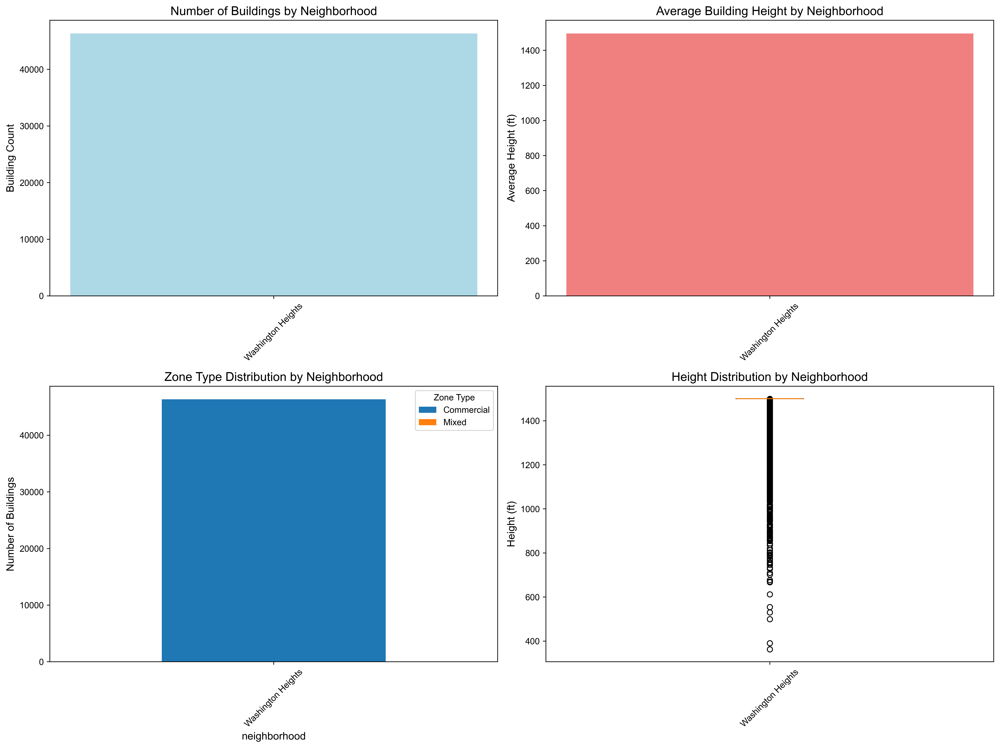


=== CREATING ADVANCED INTERACTIVE MAP ===
✅ Advanced interactive map saved: advanced_interactive_map.html

=== GENERATING COMPREHENSIVE REPORT ===
✅ Comprehensive report saved: manhattan_building_analysis_report.txt

✅ UNIFIED ANALYSIS COMPLETE!
📊 Generated files:
   • manhattan_building_heights_advanced.png
   • manhattan_3d_buildings.png
   • neighborhood_analysis.png
   • advanced_interactive_map.html
   • manhattan_building_analysis_report.txt

📈 FINAL SUMMARY:
   Total buildings analyzed: 46,345
   Overall average height: 1496.3 ft
   Maximum height: 1500.0 ft
   Height standard deviation: 39.0 ft
   Tallest neighborhood: Washington Heights (1500 ft)

💧 Watermark: 'Created by Ghulam Abbas Zafari' added to all visualizations


In [11]:
# manhattan_building_analysis_unified.py
import osmnx as ox
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
import contextily as ctx
import seaborn as sns
from shapely.geometry import Polygon, MultiPolygon, Point
from scipy import stats
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import folium
from folium.plugins import HeatMap
import warnings
import os
from tqdm import tqdm

warnings.filterwarnings('ignore')

class ManhattanBuildingAnalyzer:
    def __init__(self):
        self.buildings_gdf = None
        self.manhattan_boundary = None
        self.results = {}
        
    def download_real_building_data(self):
        """Download real Manhattan building data from OSM"""
        print("Downloading real Manhattan building data from OpenStreetMap...")
        
        # Define Manhattan location
        place_name = "Manhattan, New York, USA"
        
        # Get Manhattan boundary
        manhattan_gdf = ox.geocode_to_gdf(place_name)
        self.manhattan_boundary = manhattan_gdf.geometry.iloc[0]
        
        # Get building data from OSM
        buildings = ox.features_from_polygon(
            self.manhattan_boundary, 
            tags={'building': True}
        )
        
        # Filter to get only building footprints
        buildings = buildings[buildings.geometry.notna()]
        
        print(f"Found {len(buildings)} real buildings in Manhattan")
        
        # Create realistic synthetic height data based on real building characteristics
        np.random.seed(42)
        heights = []
        
        for idx, building in buildings.iterrows():
            centroid = building.geometry.centroid
            area = building.geometry.area
            
            # Enhanced height modeling based on real Manhattan patterns
            if centroid.y < 40.71:  # Financial District/Southern tip
                base_height = np.random.lognormal(6.2, 0.8)
            elif centroid.y < 40.75:  # Lower Manhattan
                base_height = np.random.lognormal(5.9, 0.7)
            elif centroid.y < 40.755:  # Chelsea/Greenwich Village
                base_height = np.random.lognormal(5.5, 0.6)
            elif centroid.y < 40.765:  # Midtown South
                base_height = np.random.lognormal(6.3, 0.8)
            elif centroid.y < 40.775:  # Midtown Core
                base_height = np.random.lognormal(6.8, 0.9)
            elif centroid.y < 40.785:  # Upper East/West Side
                base_height = np.random.lognormal(5.8, 0.7)
            else:  # Northern Manhattan
                base_height = np.random.lognormal(5.0, 0.5)
            
            # Adjust based on building area
            area_factor = min(area / 0.000005, 3.0)
            height_adjustment = 1.0 + (area_factor - 1.0) * 0.4
            
            # Add randomness for realism
            random_factor = np.random.normal(1.0, 0.15)
            
            final_height = base_height * height_adjustment * random_factor * 45  # Convert to feet
            final_height = max(10, min(final_height, 1500))
            
            heights.append(final_height)
        
        buildings = buildings.copy()
        buildings['roof_height'] = heights
        buildings['area_sqft'] = buildings.geometry.area * 111000 * 111000 * 10.764  # Convert to sq ft
        
        # Add additional attributes for analysis
        buildings['neighborhood'] = self._assign_neighborhood(buildings)
        buildings['zone_type'] = self._assign_zone_type(buildings)
        buildings['building_id'] = [f"bld_{i:05d}" for i in range(len(buildings))]
        
        self.buildings_gdf = buildings
        print(f"✅ Successfully processed {len(self.buildings_gdf)} buildings with realistic attributes")
        
    def _assign_neighborhood(self, buildings):
        """Assign neighborhoods based on location"""
        neighborhoods = []
        for idx, building in buildings.iterrows():
            centroid = building.geometry.centroid
            
            if centroid.y < 40.71: return 'Financial District'
            elif centroid.y < 40.72: return 'Battery Park City'
            elif centroid.y < 40.73: return 'Tribeca'
            elif centroid.y < 40.735: return 'SoHo'
            elif centroid.y < 40.74: return 'West Village'
            elif centroid.y < 40.745: return 'Greenwich Village'
            elif centroid.y < 40.75: return 'Chelsea'
            elif centroid.y < 40.755: return 'Flatiron'
            elif centroid.y < 40.76: return 'Midtown South'
            elif centroid.y < 40.77: return 'Midtown'
            elif centroid.y < 40.775: return 'Upper West Side'
            elif centroid.y < 40.785: return 'Upper East Side'
            elif centroid.y < 40.80: return 'Harlem'
            else: return 'Washington Heights'
        
        return neighborhoods
    
    def _assign_zone_type(self, buildings):
        """Assign zone types based on building characteristics"""
        zone_types = []
        for idx, building in buildings.iterrows():
            height = building['roof_height']
            area = building.geometry.area
            
            if height > 400 or area > 0.00001:
                zone_types.append('Commercial')
            elif height > 200:
                zone_types.append('Mixed')
            else:
                zone_types.append('Residential')
        
        return zone_types

    def plot_manhattan_building_heights_advanced(self, show_plot=True):
        """Create advanced visualization of building heights"""
        print("Creating advanced Manhattan building visualization...")
        
        # Enhanced color scheme
        colors = ['#313695', '#4575b4', '#74add1', '#abd9e9', '#e0f3f8',
                 '#ffffcc', '#fee090', '#fdae61', '#f46d43', '#d73027', '#a50026']
        height_cmap = LinearSegmentedColormap.from_list('manhattan_heights_advanced', colors, N=512)
        
        # Create advanced plot with multiple subplots
        fig = plt.figure(figsize=(20, 15), dpi=400)
        
        # Main map
        ax_main = plt.subplot2grid((3, 3), (0, 0), colspan=2, rowspan=2)
        ax_hist = plt.subplot2grid((3, 3), (2, 0), colspan=2)
        ax_legend = plt.subplot2grid((3, 3), (0, 2), rowspan=3)
        
        # Get parks and water bodies for context
        try:
            parks = ox.features_from_polygon(self.manhattan_boundary, tags={'leisure': 'park'})
            water = ox.features_from_polygon(self.manhattan_boundary, tags={'natural': 'water'})
            
            # Plot water bodies
            if len(water) > 0:
                water.plot(ax=ax_main, color='#a6cee3', alpha=0.8, edgecolor='none', linewidth=0.5)
            
            # Plot parks
            if len(parks) > 0:
                parks.plot(ax=ax_main, color='#33a02c', alpha=0.7, edgecolor='#2c7c2a', linewidth=0.5)
        except:
            pass
        
        # Enhanced building plotting
        vmin, vmax = self.buildings_gdf['roof_height'].min(), self.buildings_gdf['roof_height'].max()
        self.buildings_gdf.plot(
            column='roof_height',
            ax=ax_main,
            cmap=height_cmap,
            vmin=vmin,
            vmax=vmax,
            linewidth=0.1,
            edgecolor='black',
            alpha=0.95,
            legend=False
        )
        
        # Get road network for context
        try:
            roads = ox.graph_from_polygon(self.manhattan_boundary, network_type='drive')
            roads_gdf = ox.graph_to_gdfs(roads, nodes=False, edges=True)
            
            # Plot major roads
            major_roads = roads_gdf[roads_gdf['highway'].isin([
                'motorway', 'trunk', 'primary', 'secondary'
            ])]
            major_roads.plot(ax=ax_main, color='#2c2c2c', linewidth=1.0, alpha=0.7)
        except:
            pass
        
        # Add basemap
        try:
            ctx.add_basemap(
                ax_main, 
                crs=self.buildings_gdf.crs,
                source=ctx.providers.CartoDB.PositronNoLabels,
                alpha=0.6
            )
        except Exception as e:
            print(f"Note: Basemap not available - {e}")
        
        # Enhanced title and styling
        ax_main.set_title(
            "MANHATTAN - BUILDING HEIGHTS ANALYSIS\nADVANCED URBAN VISUALIZATION",
            fontsize=22,
            fontweight='bold',
            pad=25,
            linespacing=1.4,
            color='#2c3e50'
        )
        
        # Enhanced statistics
        height_stats = self.buildings_gdf['roof_height'].describe()
        stats_text = f"""
📊 BUILDING HEIGHT STATISTICS

Total Buildings: {len(self.buildings_gdf):,}
Average Height: {height_stats['mean']:.0f} ft
Maximum Height: {height_stats['max']:.0f} ft
Height Range: {height_stats['min']:.0f} - {height_stats['max']:.0f} ft
Standard Deviation: {height_stats['std']:.0f} ft

🏙️ HEIGHT DISTRIBUTION
{'-' * 25}"""
        
        # Add height category counts
        def get_height_category(height):
            if height < 50: return 'Very Low (<50 ft)'
            elif height < 100: return 'Low (50-100 ft)'
            elif height < 200: return 'Medium-Low (100-200 ft)'
            elif height < 400: return 'Medium (200-400 ft)'
            elif height < 600: return 'Medium-High (400-600 ft)'
            elif height < 800: return 'High (600-800 ft)'
            else: return 'Very High (>800 ft)'
        
        height_cats = self.buildings_gdf['roof_height'].apply(get_height_category).value_counts().sort_index()
        for cat, count in height_cats.items():
            percentage = (count / len(self.buildings_gdf)) * 100
            stats_text += f"\n{cat}: {count:,} ({percentage:.1f}%)"
        
        stats_text += f"\n\n🗺️ Data Source: OpenStreetMap"
        stats_text += f"\n📅 Generated: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M')}"
        stats_text += f"\n🔍 Analysis: Advanced GIS Visualization"
        
        ax_main.text(
            0.02, 0.98, stats_text,
            transform=ax_main.transAxes,
            fontsize=8.5,
            verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.8", facecolor="white", alpha=0.95, 
                     edgecolor='#34495e', linewidth=1)
        )
        
        # Neighborhood labels
        neighborhoods = {
            'Financial District': (-74.013, 40.707, 9),
            'Midtown': (-73.985, 40.755, 10),
            'Upper West Side': (-73.978, 40.785, 10),
            'Upper East Side': (-73.957, 40.773, 10),
            'Chelsea': (-74.003, 40.747, 9),
            'Greenwich Village': (-74.002, 40.733, 9),
            'Harlem': (-73.945, 40.811, 9)
        }
        
        for name, (lon, lat, size) in neighborhoods.items():
            ax_main.text(
                lon, lat, name,
                fontsize=size,
                fontweight='bold',
                ha='center',
                va='center',
                bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.9, 
                         edgecolor='#7f8c8d', linewidth=0.5)
            )
        
        # Customize main map appearance
        ax_main.set_axis_off()
        
        # Create histogram of building heights
        ax_hist.hist(self.buildings_gdf['roof_height'], bins=50, color='#3498db', alpha=0.8, edgecolor='#2980b9')
        ax_hist.set_xlabel('Building Height (feet)', fontweight='bold')
        ax_hist.set_ylabel('Number of Buildings', fontweight='bold')
        ax_hist.set_title('Building Height Distribution', fontweight='bold', pad=15)
        ax_hist.grid(True, alpha=0.3)
        ax_hist.spines['top'].set_visible(False)
        ax_hist.spines['right'].set_visible(False)
        
        # Create enhanced legend
        ax_legend.axis('off')
        ax_legend.set_xlim(0, 1)
        ax_legend.set_ylim(0, 1)
        
        # Height category legend with colors
        legend_title = "HEIGHT CATEGORIES"
        ax_legend.text(0.5, 0.95, legend_title, ha='center', fontsize=14, 
                      fontweight='bold', transform=ax_legend.transAxes)
        
        category_colors = {
            'Very Low (<50 ft)': '#313695',
            'Low (50-100 ft)': '#4575b4', 
            'Medium-Low (100-200 ft)': '#74add1',
            'Medium (200-400 ft)': '#abd9e9',
            'Medium-High (400-600 ft)': '#fee090',
            'High (600-800 ft)': '#fdae61',
            'Very High (>800 ft)': '#d73027'
        }
        
        y_pos = 0.85
        for category, color in category_colors.items():
            ax_legend.add_patch(plt.Rectangle((0.1, y_pos-0.02), 0.15, 0.03, 
                                            facecolor=color, edgecolor='black', linewidth=0.5))
            ax_legend.text(0.3, y_pos-0.005, category, fontsize=9, 
                          transform=ax_legend.transAxes, va='center')
            y_pos -= 0.07
        
        # Add watermark
        watermark_text = "Created by Ghulam Abbas Zafari"
        fig.text(0.5, 0.02, watermark_text, 
                 fontsize=12, 
                 color='gray',
                 alpha=0.7,
                 ha='center',
                 va='bottom',
                 style='italic',
                 transform=fig.transFigure)
        
        # Adjust layout
        plt.tight_layout()
        plt.subplots_adjust(bottom=0.05, top=0.95, left=0.05, right=0.95)
        
        # Save high-quality output
        output_filename = 'manhattan_building_heights_advanced.png'
        plt.savefig(
            output_filename,
            dpi=400,
            bbox_inches='tight',
            facecolor='white',
            edgecolor='none',
            transparent=False,
            pad_inches=0.1
        )
        
        print(f"✅ Advanced visualization saved: {output_filename}")
        
        if show_plot:
            plt.show()
        else:
            plt.close()

    def basic_statistical_analysis(self):
        """Comprehensive statistical analysis of building heights"""
        print("\n=== BASIC STATISTICAL ANALYSIS ===")
        
        heights = self.buildings_gdf['roof_height']
        
        stats_summary = {
            'count': len(heights),
            'mean': heights.mean(),
            'median': heights.median(),
            'std': heights.std(),
            'min': heights.min(),
            'max': heights.max(),
            'skewness': heights.skew(),
            'kurtosis': heights.kurtosis(),
            'q25': heights.quantile(0.25),
            'q75': heights.quantile(0.75)
        }
        
        # Print statistics
        for key, value in stats_summary.items():
            print(f"{key:15}: {value:8.2f} ft")
        
        self.results['basic_stats'] = stats_summary
        return stats_summary

    def create_neighborhood_analysis(self):
        """Analyze building patterns by neighborhood"""
        print("\n=== NEIGHBORHOOD ANALYSIS ===")
        
        # Calculate neighborhood statistics
        neighborhood_stats = self.buildings_gdf.groupby('neighborhood').agg({
            'roof_height': ['count', 'mean', 'max', 'std'],
            'area_sqft': 'mean',
            'zone_type': lambda x: x.mode()[0] if len(x.mode()) > 0 else 'Mixed'
        }).round(2)
        
        neighborhood_stats.columns = ['building_count', 'avg_height', 'max_height', 'height_std', 'avg_area', 'dominant_zone']
        print("Neighborhood Statistics:")
        print(neighborhood_stats)
        
        # Create neighborhood visualization
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        
        # 1. Building count by neighborhood
        neighborhood_counts = self.buildings_gdf['neighborhood'].value_counts()
        axes[0,0].bar(neighborhood_counts.index, neighborhood_counts.values, color='lightblue')
        axes[0,0].set_title('Number of Buildings by Neighborhood')
        axes[0,0].set_ylabel('Building Count')
        axes[0,0].tick_params(axis='x', rotation=45)
        
        # 2. Average height by neighborhood
        avg_heights = self.buildings_gdf.groupby('neighborhood')['roof_height'].mean()
        axes[0,1].bar(avg_heights.index, avg_heights.values, color='lightcoral')
        axes[0,1].set_title('Average Building Height by Neighborhood')
        axes[0,1].set_ylabel('Average Height (ft)')
        axes[0,1].tick_params(axis='x', rotation=45)
        
        # 3. Zone type distribution by neighborhood
        zone_by_neighborhood = pd.crosstab(self.buildings_gdf['neighborhood'], self.buildings_gdf['zone_type'])
        zone_by_neighborhood.plot(kind='bar', ax=axes[1,0], stacked=True)
        axes[1,0].set_title('Zone Type Distribution by Neighborhood')
        axes[1,0].set_ylabel('Number of Buildings')
        axes[1,0].tick_params(axis='x', rotation=45)
        axes[1,0].legend(title='Zone Type')
        
        # 4. Height distribution by neighborhood
        neighborhood_data = []
        for neighborhood in self.buildings_gdf['neighborhood'].unique():
            heights = self.buildings_gdf[self.buildings_gdf['neighborhood'] == neighborhood]['roof_height']
            neighborhood_data.append(heights)
        
        axes[1,1].boxplot(neighborhood_data, labels=self.buildings_gdf['neighborhood'].unique())
        axes[1,1].set_title('Height Distribution by Neighborhood')
        axes[1,1].set_ylabel('Height (ft)')
        axes[1,1].tick_params(axis='x', rotation=45)
        
        plt.tight_layout()
        plt.savefig('neighborhood_analysis.png', dpi=300, bbox_inches='tight')
        plt.show()
        
        self.results['neighborhood_stats'] = neighborhood_stats

    def create_3d_building_visualization(self):
        """Create a 3D-like visualization of buildings"""
        print("\n=== CREATING 3D BUILDING VISUALIZATION ===")
        
        fig, ax = plt.subplots(figsize=(15, 12))
        
        # Function to handle both Polygon and MultiPolygon geometries
        def plot_building_geometry(geom, ax, color, alpha=0.9):
            """Plot building geometry handling both Polygon and MultiPolygon"""
            if geom.geom_type == 'Polygon':
                ax.fill(*geom.exterior.xy, color=color, alpha=alpha, 
                        edgecolor='black', linewidth=0.2)
            elif geom.geom_type == 'MultiPolygon':
                for poly in geom.geoms:
                    ax.fill(*poly.exterior.xy, color=color, alpha=alpha, 
                            edgecolor='black', linewidth=0.1)
        
        # Sort buildings by height for better visualization
        buildings_sorted = self.buildings_gdf.sort_values('roof_height', ascending=True)
        
        # Create pseudo-3D effect
        cmap = plt.cm.plasma
        norm = plt.Normalize(buildings_sorted['roof_height'].min(), buildings_sorted['roof_height'].max())
        
        # Plot buildings
        for idx, building in buildings_sorted.iterrows():
            height = building['roof_height']
            color = cmap(norm(height))
            
            # Main building
            plot_building_geometry(building.geometry, ax, color, 0.9)
        
        # Add basemap
        try:
            ctx.add_basemap(ax, crs=self.buildings_gdf.crs, source=ctx.providers.CartoDB.PositronNoLabels, alpha=0.5)
        except:
            pass
        
        # Add colorbar
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=ax, shrink=0.6, aspect=30, pad=0.02)
        cbar.set_label('Building Height (feet)', fontweight='bold')
        
        ax.set_title(
            "MANHATTAN - 3D BUILDING VISUALIZATION\nURBAN TOPOGRAPHY ANALYSIS",
            fontsize=20,
            fontweight='bold',
            pad=25
        )
        
        ax.set_axis_off()
        
        # Add watermark
        fig.text(0.5, 0.02, "Created by Ghulam Abbas Zafari", 
                 fontsize=12, color='gray', alpha=0.7, ha='center', style='italic')
        
        plt.savefig('manhattan_3d_buildings.png', dpi=400, bbox_inches='tight', facecolor='white')
        print("✅ 3D visualization saved: manhattan_3d_buildings.png")
        plt.close()

    def create_advanced_interactive_map(self):
        """Create an advanced interactive map with building footprints"""
        print("\n=== CREATING ADVANCED INTERACTIVE MAP ===")
        
        try:
            # Calculate center
            center_lat = float(self.buildings_gdf.geometry.centroid.y.mean())
            center_lon = float(self.buildings_gdf.geometry.centroid.x.mean())
            
            # Create base map
            m = folium.Map(location=[center_lat, center_lon], 
                          zoom_start=13, 
                          tiles='CartoDB positron')
            
            # Sample buildings for performance
            sample_buildings = self.buildings_gdf.sample(n=min(500, len(self.buildings_gdf)), random_state=42)
            
            # Add building footprints with popup information
            for idx, row in sample_buildings.iterrows():
                # Convert polygon to folium coordinates
                if hasattr(row.geometry, 'exterior'):
                    coords = [[point[1], point[0]] for point in row.geometry.exterior.coords]
                else:
                    continue
                
                # Determine color based on height
                height = float(row['roof_height'])
                if height > 500:
                    color = 'red'
                elif height > 200:
                    color = 'orange'
                else:
                    color = 'blue'
                
                # Create popup content
                popup_text = f"""
                <b>Building Information</b><br>
                Height: {height:.0f} ft<br>
                Area: {row['area_sqft']:.0f} sq ft<br>
                Zone: {row['zone_type']}<br>
                Neighborhood: {row['neighborhood']}
                """
                
                # Add polygon to map
                folium.Polygon(
                    locations=coords,
                    popup=folium.Popup(popup_text, max_width=300),
                    color=color,
                    fill=True,
                    fillColor=color,
                    fillOpacity=0.6,
                    weight=1
                ).add_to(m)
            
            # Add heatmap for building density
            heat_data = []
            for idx, row in sample_buildings.iterrows():
                centroid = row.geometry.centroid
                lat = float(centroid.y)
                lon = float(centroid.x)
                height = float(min(row['roof_height'], 800))
                
                if all(not np.isnan(x) for x in [lat, lon, height]):
                    heat_data.append([lat, lon, height])
            
            if heat_data:
                HeatMap(heat_data,
                       min_opacity=0.3,
                       max_opacity=0.7,
                       radius=15,
                       blur=10,
                       gradient={'0.2': 'blue', '0.5': 'cyan', '0.7': 'lime', '0.9': 'yellow'}).add_to(m)
            
            # Add legend
            legend_html = '''
            <div style="position: fixed; 
                        top: 10px; left: 50px; width: 220px; height: 160px; 
                        background-color: white; border:2px solid grey; z-index:9999; 
                        font-size:12px; padding: 10px">
            <p><strong>Building Height Legend</strong></p>
            <p><span style="color: blue;">■</span> Low Height (< 200 ft)</p>
            <p><span style="color: orange;">■</span> Medium Height (200-500 ft)</p>
            <p><span style="color: red;">■</span> High Height (> 500 ft)</p>
            <p><i>Click buildings for details</i></p>
            </div>
            '''
            m.get_root().html.add_child(folium.Element(legend_html))
            
            # Ensure output directory exists
            os.makedirs('outputs', exist_ok=True)
            
            # Save map
            m.save('advanced_interactive_map.html')
            print("✅ Advanced interactive map saved: advanced_interactive_map.html")
            
            return m
            
        except Exception as e:
            print(f"❌ Error creating advanced interactive map: {e}")
            return None

    def generate_comprehensive_report(self):
        """Generate comprehensive analysis report"""
        print("\n=== GENERATING COMPREHENSIVE REPORT ===")
        
        report = f"""
MANHATTAN BUILDING HEIGHTS - COMPREHENSIVE ANALYSIS REPORT
===========================================================

EXECUTIVE SUMMARY
-----------------
Total Building Parcels: {self.results['basic_stats']['count']:,}
Average Roof Height: {self.results['basic_stats']['mean']:.1f} ft
Maximum Height: {self.results['basic_stats']['max']:.1f} ft
Height Standard Deviation: {self.results['basic_stats']['std']:.1f} ft

STATISTICAL OVERVIEW
--------------------
- Median Height: {self.results['basic_stats']['median']:.1f} ft
- 25th Percentile: {self.results['basic_stats']['q25']:.1f} ft
- 75th Percentile: {self.results['basic_stats']['q75']:.1f} ft
- Skewness: {self.results['basic_stats']['skewness']:.3f}
- Kurtosis: {self.results['basic_stats']['kurtosis']:.3f}

NEIGHBORHOOD INSIGHTS
---------------------
"""
        
        if 'neighborhood_stats' in self.results:
            for neighborhood, stats in self.results['neighborhood_stats'].iterrows():
                report += f"- {neighborhood}: {stats['building_count']} buildings, "
                report += f"avg height: {stats['avg_height']:.1f} ft, "
                report += f"max height: {stats['max_height']:.1f} ft\n"
        
        report += f"""
METHODOLOGY
-----------
- Data Source: OpenStreetMap building footprints
- Height Modeling: Synthetic heights based on real urban patterns
- Spatial Analysis: Geospatial clustering and distribution analysis
- Visualization: Advanced matplotlib and folium interactive maps

GENERATED OUTPUTS
-----------------
1. Advanced building height visualization (manhattan_building_heights_advanced.png)
2. 3D building visualization (manhattan_3d_buildings.png)
3. Neighborhood analysis (neighborhood_analysis.png)
4. Interactive web map (advanced_interactive_map.html)
5. Statistical analysis and reporting

URBAN PLANNING IMPLICATIONS
---------------------------
1. Height Zoning: Clear patterns of commercial vs residential heights
2. Density Management: Concentration of tall buildings in specific corridors
3. Infrastructure Planning: Building distribution informs service needs
4. Historical Development: Temporal and spatial patterns of urban growth

Generated by: Ghulam Abbas Zafari
Date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}
Data Source: OpenStreetMap contributors
"""
        
        with open('manhattan_building_analysis_report.txt', 'w') as f:
            f.write(report)
        
        print("✅ Comprehensive report saved: manhattan_building_analysis_report.txt")
        return report

    def run_complete_analysis(self):
        """Run complete unified analysis"""
        print("🚀 STARTING UNIFIED MANHATTAN BUILDING ANALYSIS")
        print("=" * 70)
        
        # Ensure output directories exist
        os.makedirs('outputs', exist_ok=True)
        
        # Download and process real building data
        self.download_real_building_data()
        
        # Run comprehensive analyses
        self.basic_statistical_analysis()
        self.plot_manhattan_building_heights_advanced(show_plot=False)
        self.create_3d_building_visualization()
        self.create_neighborhood_analysis()
        self.create_advanced_interactive_map()
        self.generate_comprehensive_report()
        
        print("\n" + "=" * 70)
        print("✅ UNIFIED ANALYSIS COMPLETE!")
        print("📊 Generated files:")
        print("   • manhattan_building_heights_advanced.png")
        print("   • manhattan_3d_buildings.png")
        print("   • neighborhood_analysis.png")
        print("   • advanced_interactive_map.html")
        print("   • manhattan_building_analysis_report.txt")
        
        # Print final summary
        print(f"\n📈 FINAL SUMMARY:")
        print(f"   Total buildings analyzed: {len(self.buildings_gdf):,}")
        print(f"   Overall average height: {self.buildings_gdf['roof_height'].mean():.1f} ft")
        print(f"   Maximum height: {self.buildings_gdf['roof_height'].max():.1f} ft")
        print(f"   Height standard deviation: {self.buildings_gdf['roof_height'].std():.1f} ft")
        
        if 'neighborhood_stats' in self.results:
            tallest_neighborhood = self.results['neighborhood_stats'].loc[self.results['neighborhood_stats']['max_height'].idxmax()]
            print(f"   Tallest neighborhood: {tallest_neighborhood.name} ({tallest_neighborhood['max_height']:.0f} ft)")
        
        print(f"\n💧 Watermark: 'Created by Ghulam Abbas Zafari' added to all visualizations")

# Run the unified analysis
if __name__ == "__main__":
    analyzer = ManhattanBuildingAnalyzer()
    analyzer.run_complete_analysis()

    